In [36]:
import os
import sys
sys.path.append('../')
import itertools
from random import shuffle 
from collections import Counter

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib.pyplot import cm
from torch_geometric.data import Data, Dataset
from torch_geometric.loader import DataLoader
import torch.nn.functional as F
from matplotlib import pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.pyplot import cm
from sklearn.cluster import DBSCAN
import mplhep as hep
plt.style.use(hep.style.CMS)

from models.graph_dataset import GraphDataset
from models.track_condensation_network import TCN
from models.condensation_loss import *

In [37]:
# list of hyperparameters used in scan
q_min = [0.001, 0.01, 0.1, 1]
sb = [0.001, 0.01, 0.1, 1]
lr = [0.0001, 0.001, 0.01]
params = list(itertools.product(q_min, sb, lr))

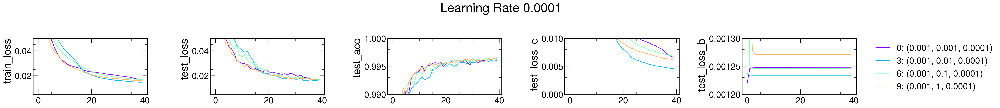

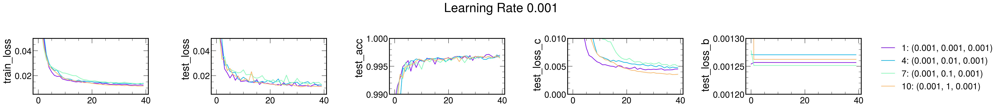

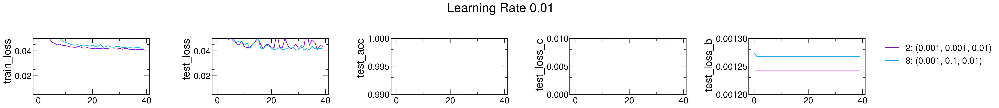

In [39]:
indir = 'scan_train1_ptmin1_q_sb_lr'
train_files = np.array([f for f in os.listdir(indir)
                        if 'train1_ptmin1' in f])
job_numbers = np.array([int(f.split('.')[0].split('_')[-1])
                        for f in train_files])
sorted_args = np.argsort(job_numbers)
files = {os.path.join(indir, train_files[i]): job_numbers[i]
         for i in sorted_args}

for l in lr: 
    fig, axs = plt.subplots(ncols=5, dpi=200, figsize=(35,4))
    color = iter(cm.rainbow(np.linspace(0, 1, 5)))
    for f, idx in files.items():
        df = pd.read_csv(f, skiprows=19, index_col=0)
        p = params[idx]
        if p[2]!=l: continue
        if (df['test_loss'].values[-1] > 0.05): continue
        #if (df['test_loss_c'].values[-1] < 0.00005): 
        #    print(p, df['test_loss_c'].values[-1])
        c = next(color)
        axs[0].plot(df['train_loss'], label=f"{idx}: {p}", c=c)
        axs[1].plot(df['test_loss'], label=f"{idx}: {p}", c=c)
        axs[2].plot(df['test_acc'], label=f"{idx}: {p}", c=c)
        axs[3].plot(df['train_loss_c'], label=f"{idx}: {p}", c=c)
        axs[4].plot(df['train_loss_b'], label=f"{idx}: {p}", c=c)
    
    axs[0].set_ylabel('train_loss')
    axs[1].set_ylabel('test_loss')
    axs[2].set_ylabel('test_acc')
    axs[3].set_ylabel('test_loss_c')
    axs[4].set_ylabel('test_loss_b')
    axs[0].set_ylim([0.005,0.05])
    axs[1].set_ylim([0.005,0.05])
    axs[2].set_ylim([0.99,1])
    axs[3].set_ylim([0.0, 0.01])
    axs[4].set_ylim([0.0012, 0.0013])
    axs[4].legend(bbox_to_anchor=(1.1, 1.05))
    plt.suptitle(f"Learning Rate {l}")
    plt.tight_layout()
    plt.show()


In [52]:
from scipy.spatial import cKDTree

# pick a model and optimize its performance 
device = 'cpu'
model = 'job_10_epoch40.pt'
gnn = TCN(3, 4, 2).to(device)
gnn.load_state_dict(torch.load(os.path.join(indir,model),
                    map_location=torch.device(device)))

input_dir = '../graphs/train1_ptmin1'
graph_files = np.array(os.listdir(input_dir))
graph_paths = np.array([os.path.join(input_dir, graph_file)
                        for graph_file in graph_files][:10000])

params = {'batch_size': 1, 'shuffle': False, 'num_workers': 4}
test_set = GraphDataset(graph_files=graph_paths)
test_loader = DataLoader(test_set, **params)

In [71]:
gnn.eval()
thld = 0.15195
output = {'test_loss': [], 'test_acc': []}
eps_per_sector = {str(i): [] for i in range(64)}
with torch.no_grad():
    for batch_idx, (data, f) in enumerate(test_loader):
        sector = f[0].split('_s')[-1].split('.npz')[0]
        data = data.to(device)
        out, xc, beta = gnn(data.x, data.edge_index, data.edge_attr)
        y, out = data.y, out.squeeze(1)
        particle_id = data.particle_id
        min_dists = []
        for pid in particle_id:
            if pid==0: continue
            xc_pid = xc[particle_id==pid]
            tree = cKDTree(xc_pid)
            nn_dists = []
            for x in xc_pid:
                nns = tree.query(x, 2)
                nn_dist = nns[0][1]
                nn_dists.append(nn_dist)
            min_dists.append(np.nanmean(nn_dists))
    
        mean_min_dist = np.nanmean(min_dists)
        if np.isfinite(mean_min_dist):
            eps_per_sector[sector].append(mean_min_dist)    
            
        if not batch_idx%100: print(batch_idx)

0
100
200
300
400
500
600
700
800
900
1000
1100
1200


/tmp/ipykernel_309637/2105582404.py:22: RuntimeWarning: Mean of empty slice
  min_dists.append(np.nanmean(nn_dists))
/tmp/ipykernel_309637/2105582404.py:24: RuntimeWarning: Mean of empty slice
  mean_min_dist = np.nanmean(min_dists)


1300
1400
1500
1600
1700
1800
1900
2000
2100
2200
2300
2400
2500
2600
2700
2800
2900
3000
3100
3200
3300
3400
3500
3600
3700
3800
3900
4000
4100
4200
4300
4400
4500
4600
4700
4800
4900
5000
5100
5200
5300
5400
5500
5600
5700
5800
5900
6000
6100
6200
6300
6400
6500
6600
6700
6800
6900
7000
7100
7200
7300
7400
7500
7600
7700
7800
7900
8000
8100
8200
8300
8400
8500
8600
8700
8800
8900
9000
9100
9200
9300
9400
9500
9600
9700
9800
9900


In [81]:
eps = {s: np.mean(d)+3*np.std(d) for s, d in eps_per_sector.items()}
eps

{'0': 0.05900707277432181,
 '1': 0.10170387727270888,
 '2': 0.17194680428746068,
 '3': 0.23004247261837135,
 '4': 0.2243000257613494,
 '5': 0.16836514406942193,
 '6': 0.10254684209017025,
 '7': 0.10207260532785836,
 '8': 0.12295615984095759,
 '9': 0.09200416903239134,
 '10': 0.15815845872685624,
 '11': 0.21405762450704335,
 '12': 0.3200734945315524,
 '13': 0.18905780781055143,
 '14': 0.09143106488509523,
 '15': 0.03502290421345094,
 '16': 0.0398942822677689,
 '17': 0.07472349143548182,
 '18': 0.20357939549743737,
 '19': 0.23531493971226253,
 '20': 0.20665694908376703,
 '21': 0.14964815578412144,
 '22': 0.09235492446250376,
 '23': 0.056250982401711634,
 '24': 0.03855744669359273,
 '25': 0.08513860730538295,
 '26': 0.1897803964437022,
 '27': 0.21953892167219724,
 '28': 0.2585820625229885,
 '29': 0.21476831121829165,
 '30': 0.08702137561877263,
 '31': 0.06133204292841071,
 '32': 0.09414566512407252,
 '33': 0.10849806592400216,
 '34': 0.17236667623611393,
 '35': 0.25376245109864837,
 '36':

In [88]:
# look at the results on a single event (1200)
device = 'cpu'
model = 'job_10_epoch40.pt'
gnn = TCN(3, 4, 2).to(device)
gnn.load_state_dict(torch.load(os.path.join(indir,model),
                    map_location=torch.device(device)))

input_dir = '../graphs/train1_ptmin1'
evt_of_interest = '1104'
graph_files = np.array(os.listdir(input_dir))
graph_paths = np.array([os.path.join(input_dir, graph_file)
                        for graph_file in graph_files
                        if evt_of_interest in graph_file])
print(f'examining {len(graph_paths)} files:\n', graph_paths)

params = {'batch_size': 1, 'shuffle': True, 'num_workers': 1}
test_set = GraphDataset(graph_files=graph_paths)
test_loader = DataLoader(test_set, **params)

examining 64 files:
 ['../graphs/train1_ptmin1/event000001104_s8.npz'
 '../graphs/train1_ptmin1/event000001104_s57.npz'
 '../graphs/train1_ptmin1/event000001104_s60.npz'
 '../graphs/train1_ptmin1/event000001104_s44.npz'
 '../graphs/train1_ptmin1/event000001104_s19.npz'
 '../graphs/train1_ptmin1/event000001104_s14.npz'
 '../graphs/train1_ptmin1/event000001104_s40.npz'
 '../graphs/train1_ptmin1/event000001104_s63.npz'
 '../graphs/train1_ptmin1/event000001104_s61.npz'
 '../graphs/train1_ptmin1/event000001104_s24.npz'
 '../graphs/train1_ptmin1/event000001104_s42.npz'
 '../graphs/train1_ptmin1/event000001104_s22.npz'
 '../graphs/train1_ptmin1/event000001104_s26.npz'
 '../graphs/train1_ptmin1/event000001104_s58.npz'
 '../graphs/train1_ptmin1/event000001104_s34.npz'
 '../graphs/train1_ptmin1/event000001104_s37.npz'
 '../graphs/train1_ptmin1/event000001104_s16.npz'
 '../graphs/train1_ptmin1/event000001104_s43.npz'
 '../graphs/train1_ptmin1/event000001104_s51.npz'
 '../graphs/train1_ptmin1/even

('../graphs/train1_ptmin1/event000001104_s43.npz',)
analyzing sector 43
condensation loss 0.004448879510164261
edge weight loss tensor(0.0079)
condensation loss tensor(0.0044)
number of particles 29
number of tracks: 28
number of labels: 31
perfect match fraction: 0.75
double majority fraction: 0.8928571428571429
lhc loose fraction: 0.75


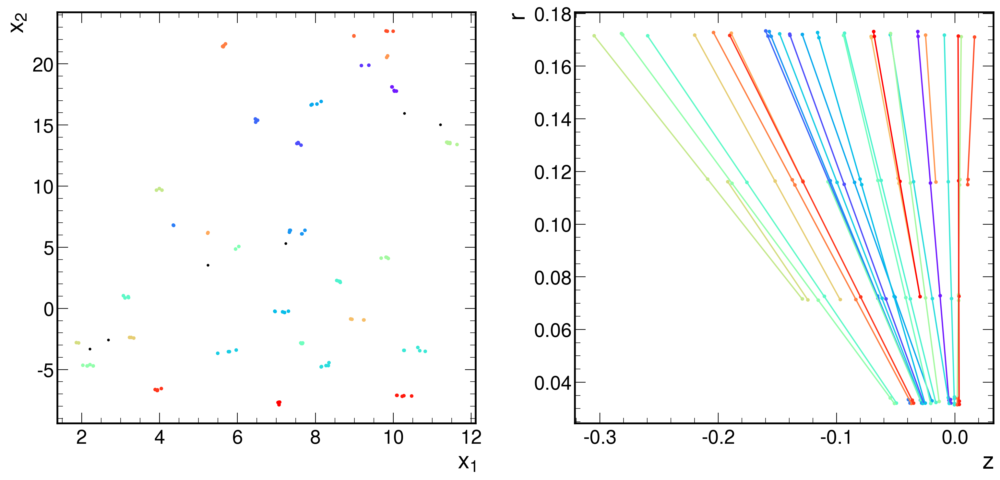

('../graphs/train1_ptmin1/event000001104_s27.npz',)
analyzing sector 27
condensation loss 0.014076641760766506
edge weight loss tensor(0.0233)
condensation loss tensor(0.0141)
number of particles 42
number of tracks: 39
number of labels: 40
perfect match fraction: 0.8461538461538461
double majority fraction: 0.9487179487179487
lhc loose fraction: 0.9230769230769231


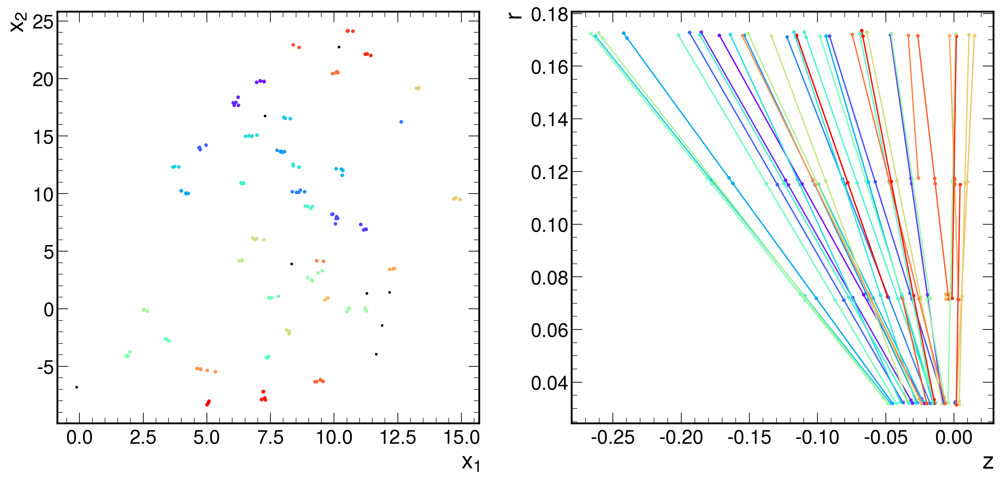

('../graphs/train1_ptmin1/event000001104_s33.npz',)
analyzing sector 33
condensation loss 0.007053293287754059
edge weight loss tensor(0.0279)
condensation loss tensor(0.0071)
number of particles 22
number of tracks: 22
number of labels: 27
perfect match fraction: 0.8636363636363636
double majority fraction: 0.9545454545454546
lhc loose fraction: 0.8636363636363636


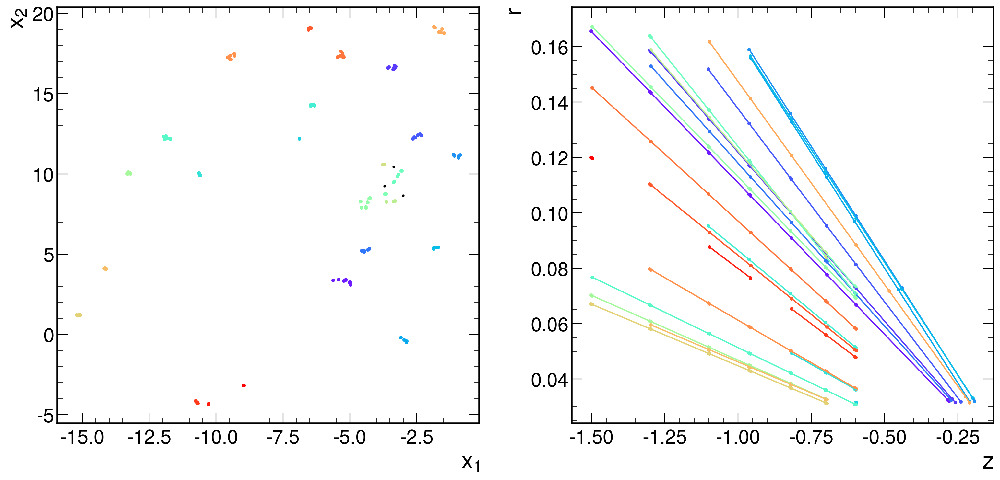

('../graphs/train1_ptmin1/event000001104_s21.npz',)
analyzing sector 21
condensation loss 0.003064095973968506
edge weight loss tensor(0.0048)
condensation loss tensor(0.0031)
number of particles 45
number of tracks: 44
number of labels: 40
perfect match fraction: 0.8181818181818182
double majority fraction: 0.8863636363636364
lhc loose fraction: 0.9090909090909091


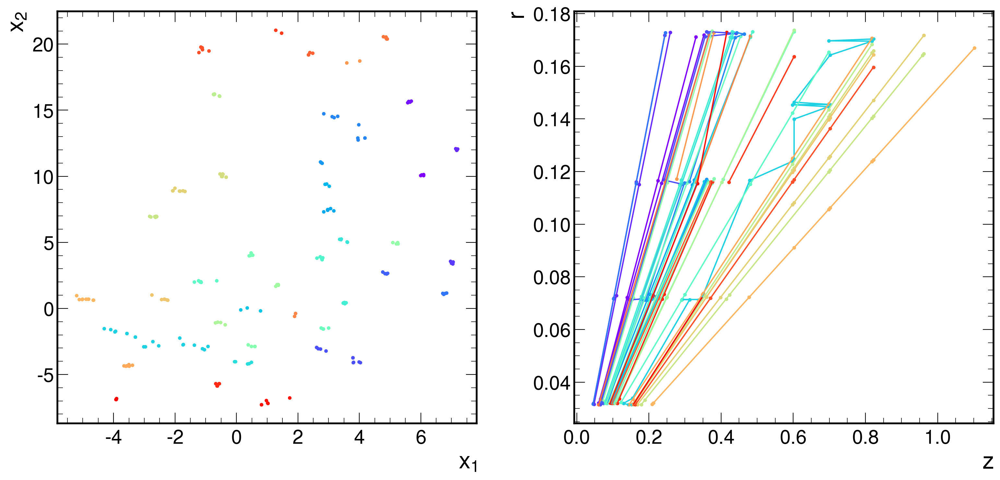

('../graphs/train1_ptmin1/event000001104_s44.npz',)
analyzing sector 44
condensation loss 0.000943399965763092
edge weight loss tensor(0.0029)
condensation loss tensor(0.0009)
number of particles 30
number of tracks: 30
number of labels: 30
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


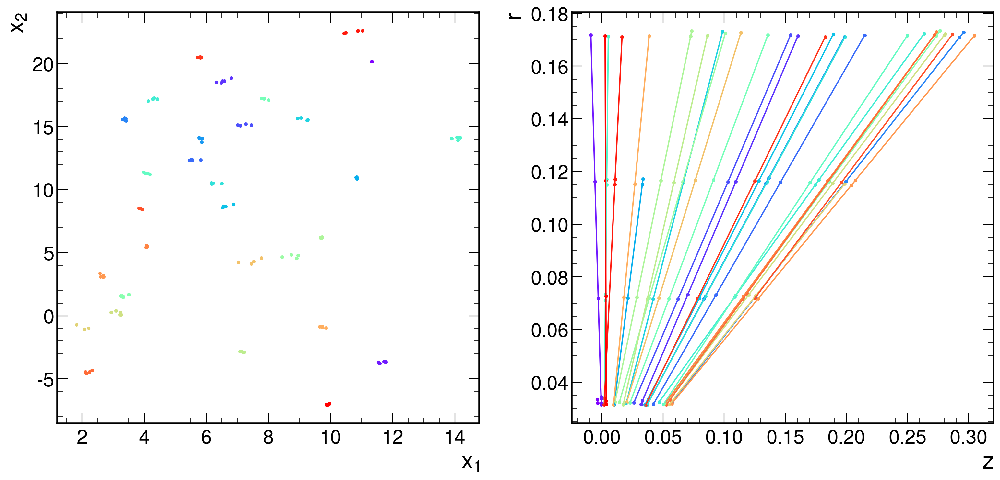

('../graphs/train1_ptmin1/event000001104_s37.npz',)
analyzing sector 37
condensation loss 0.008142292499542236
edge weight loss tensor(0.0177)
condensation loss tensor(0.0081)
number of particles 47
number of tracks: 44
number of labels: 47
perfect match fraction: 0.7727272727272727
double majority fraction: 0.9090909090909091
lhc loose fraction: 0.8181818181818182


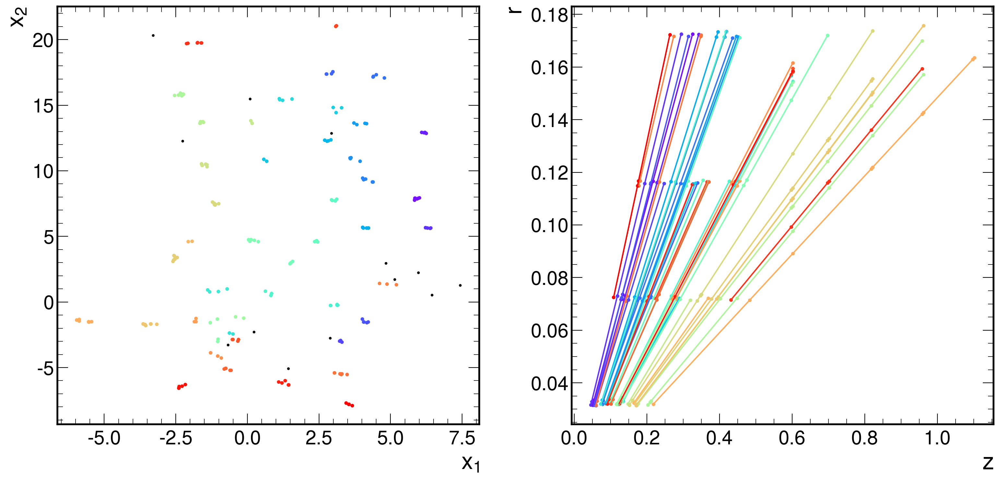

('../graphs/train1_ptmin1/event000001104_s40.npz',)
analyzing sector 40
condensation loss 0.00022222957341000438
edge weight loss tensor(0.0004)
condensation loss tensor(0.0002)
number of particles 2
number of tracks: 2
number of labels: 2
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


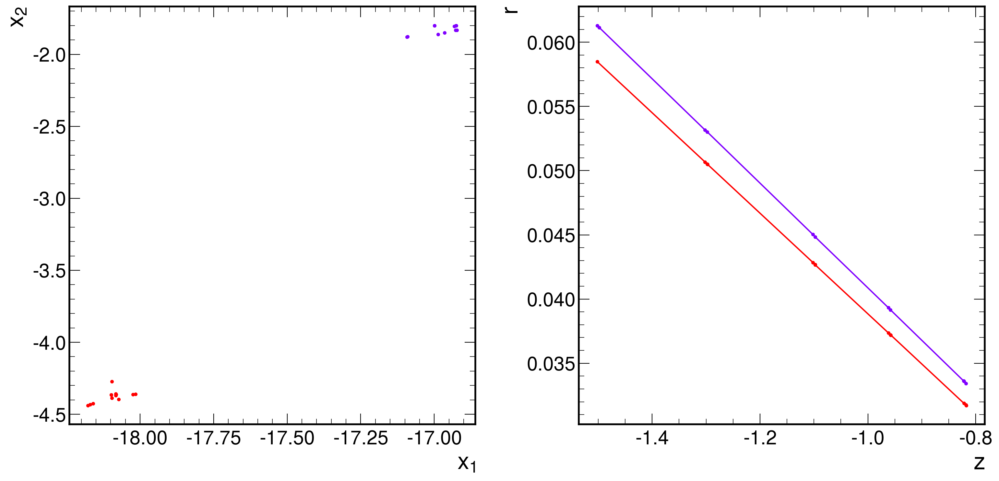

('../graphs/train1_ptmin1/event000001104_s12.npz',)
analyzing sector 12
condensation loss 0.003281534183770418
edge weight loss tensor(0.0088)
condensation loss tensor(0.0033)
number of particles 44
number of tracks: 41
number of labels: 41
perfect match fraction: 0.8292682926829268
double majority fraction: 0.975609756097561
lhc loose fraction: 0.9024390243902439


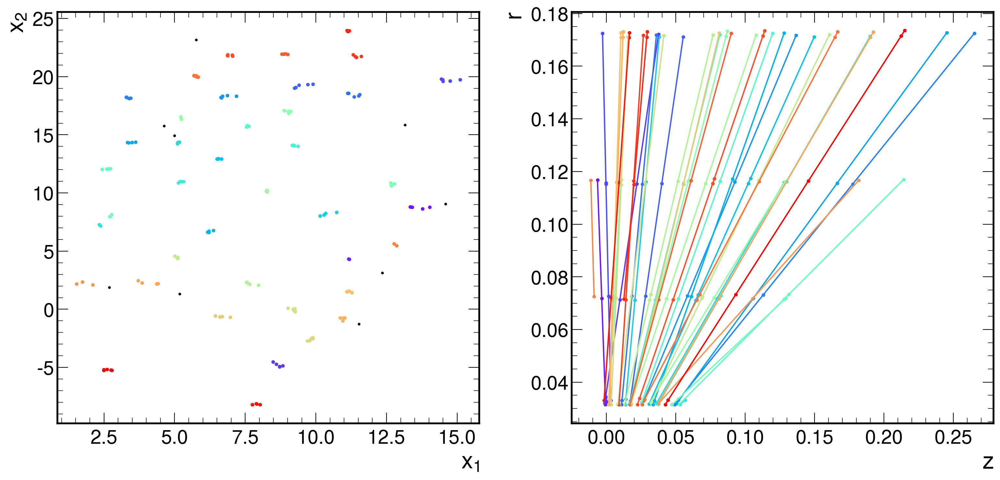

('../graphs/train1_ptmin1/event000001104_s26.npz',)
analyzing sector 26
condensation loss 0.0039627584628760815
edge weight loss tensor(0.0090)
condensation loss tensor(0.0040)
number of particles 30
number of tracks: 29
number of labels: 31
perfect match fraction: 0.896551724137931
double majority fraction: 1.0
lhc loose fraction: 0.9655172413793104


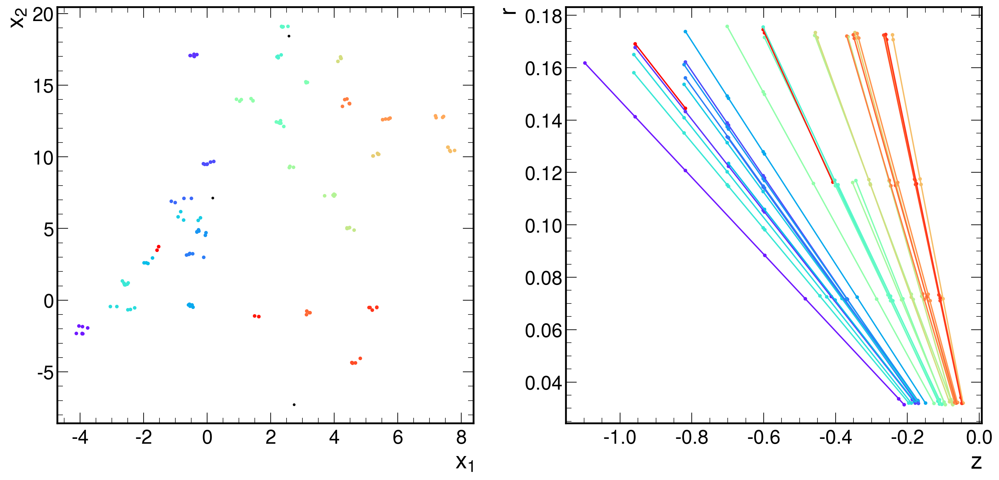

('../graphs/train1_ptmin1/event000001104_s14.npz',)
analyzing sector 14
condensation loss 0.007104848045855761
edge weight loss tensor(0.0074)
condensation loss tensor(0.0071)
number of particles 34
number of tracks: 33
number of labels: 42
perfect match fraction: 0.6666666666666666
double majority fraction: 0.9090909090909091
lhc loose fraction: 0.8181818181818182


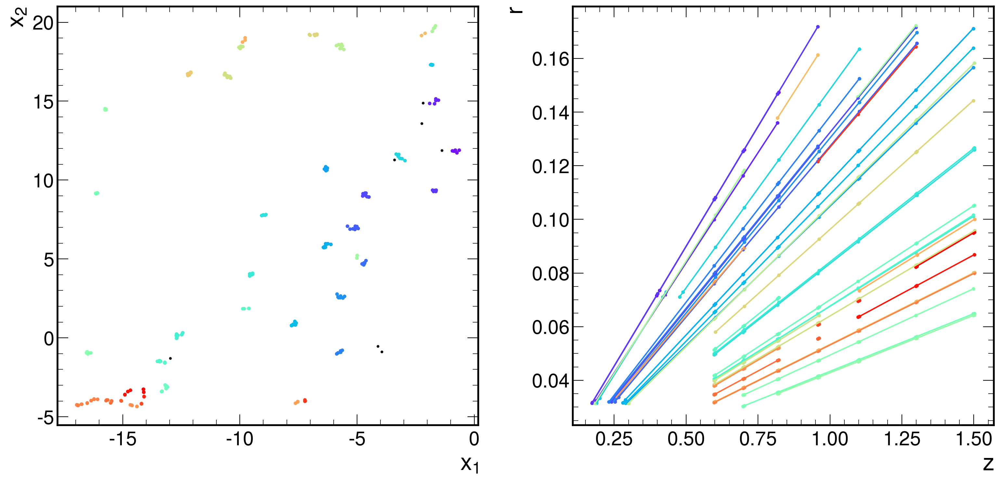

('../graphs/train1_ptmin1/event000001104_s6.npz',)
analyzing sector 6
condensation loss 0.0013179888483136892
edge weight loss tensor(0.0016)
condensation loss tensor(0.0013)
number of particles 36
number of tracks: 35
number of labels: 38
perfect match fraction: 0.9142857142857143
double majority fraction: 1.0
lhc loose fraction: 0.9714285714285714


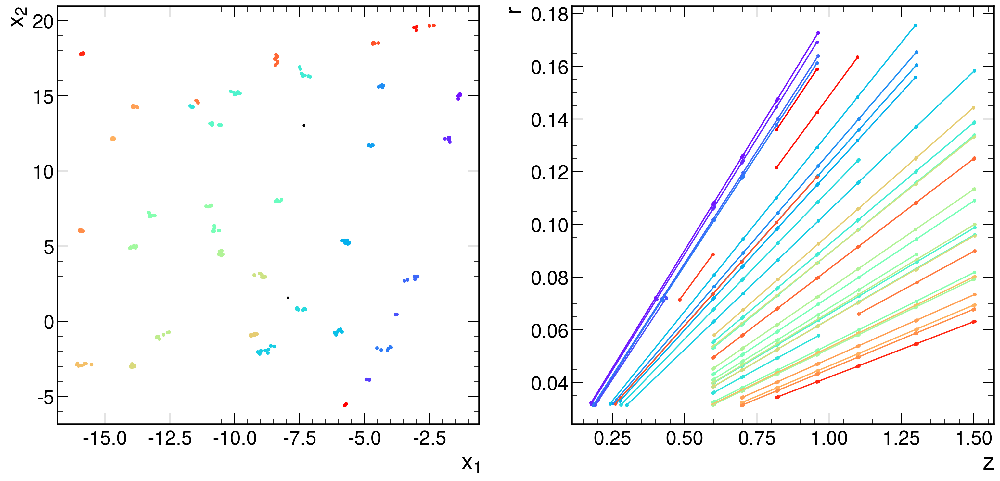

('../graphs/train1_ptmin1/event000001104_s48.npz',)
analyzing sector 48
condensation loss 0.0004869739059358835
edge weight loss tensor(0.0005)
condensation loss tensor(0.0005)
number of particles 4
number of tracks: 4
number of labels: 4
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


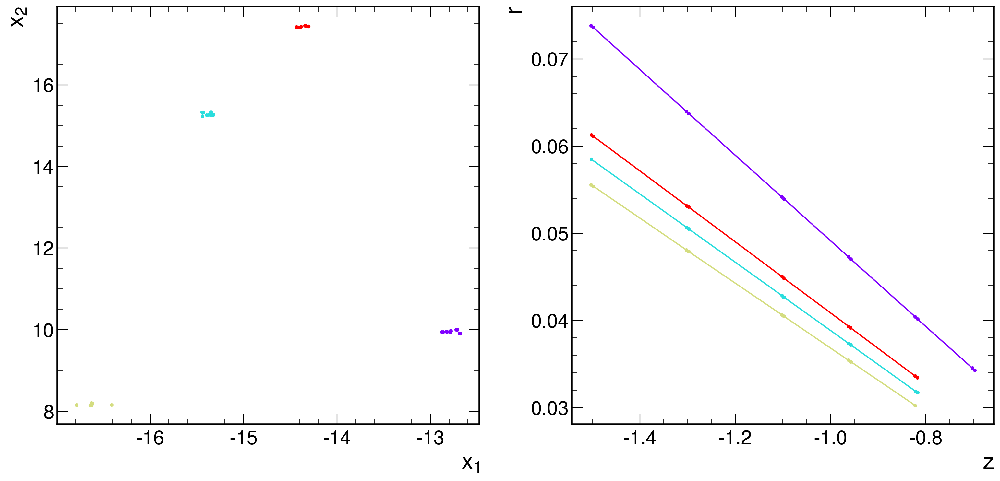

('../graphs/train1_ptmin1/event000001104_s32.npz',)
analyzing sector 32
condensation loss 0.0003201679792255163
edge weight loss tensor(0.0007)
condensation loss tensor(0.0003)
number of particles 6
number of tracks: 6
number of labels: 6
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


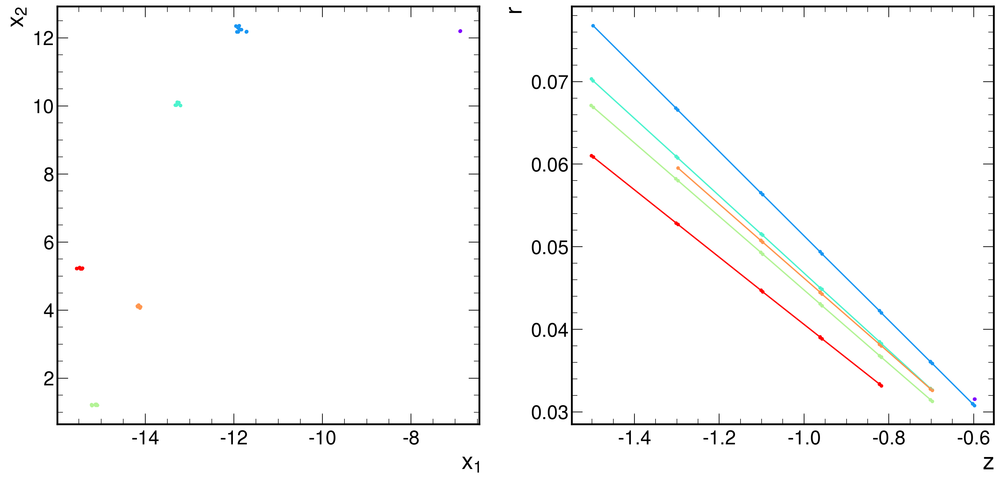

('../graphs/train1_ptmin1/event000001104_s1.npz',)
analyzing sector 1
condensation loss 0.004375091753900051
edge weight loss tensor(0.0062)
condensation loss tensor(0.0044)
number of particles 21
number of tracks: 20
number of labels: 21
perfect match fraction: 0.85
double majority fraction: 0.95
lhc loose fraction: 0.95


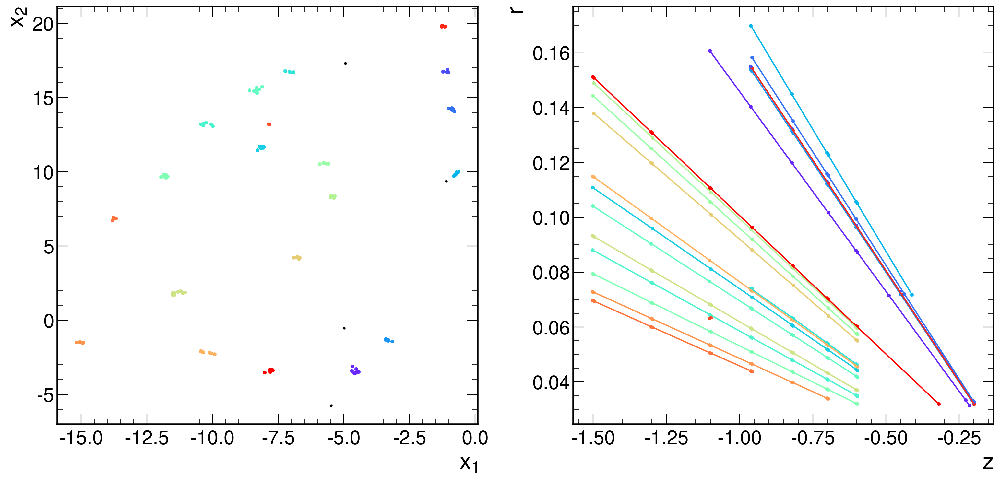

('../graphs/train1_ptmin1/event000001104_s56.npz',)
analyzing sector 56
condensation loss 0.0026502974797040224
edge weight loss tensor(0.0027)
condensation loss tensor(0.0027)
number of particles 4
number of tracks: 4
number of labels: 5
perfect match fraction: 0.75
double majority fraction: 1.0
lhc loose fraction: 0.75


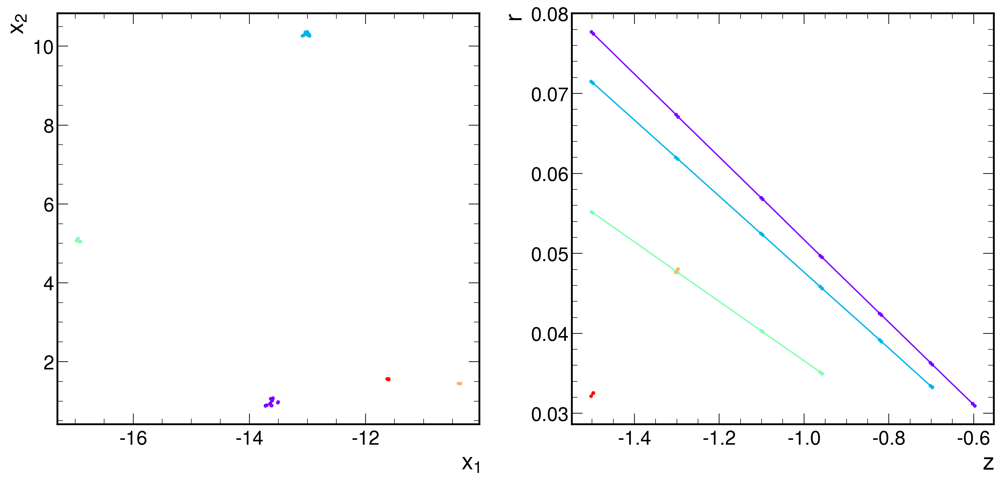

('../graphs/train1_ptmin1/event000001104_s10.npz',)
analyzing sector 10
condensation loss 0.0005290471017360687
edge weight loss tensor(0.0033)
condensation loss tensor(0.0005)
number of particles 23
number of tracks: 23
number of labels: 23
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


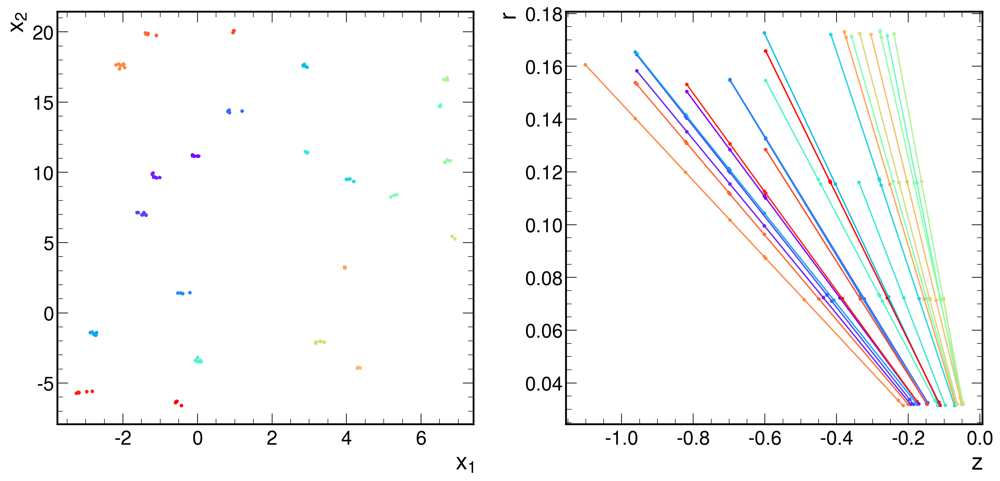

('../graphs/train1_ptmin1/event000001104_s38.npz',)
analyzing sector 38
condensation loss 0.004655216820538044
edge weight loss tensor(0.0050)
condensation loss tensor(0.0047)
number of particles 36
number of tracks: 35
number of labels: 44
perfect match fraction: 0.7142857142857143
double majority fraction: 0.9428571428571428
lhc loose fraction: 0.8


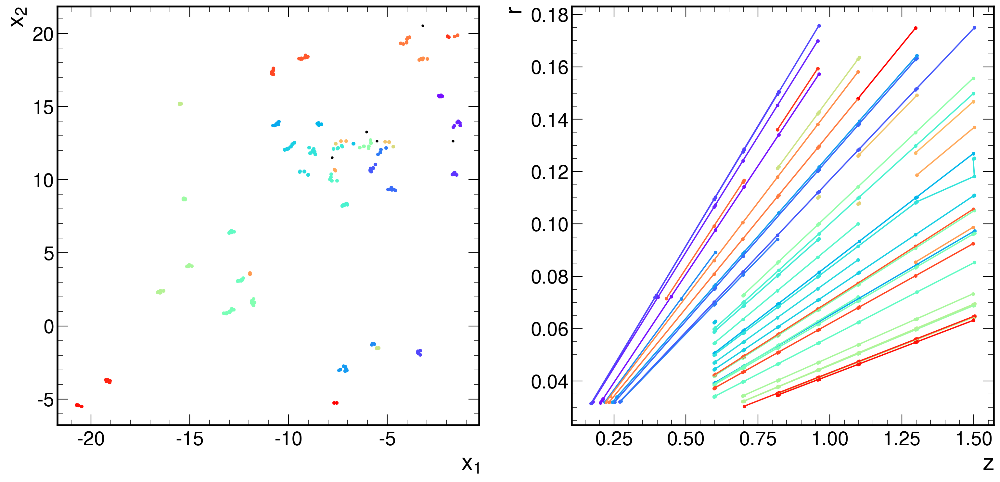

('../graphs/train1_ptmin1/event000001104_s8.npz',)
analyzing sector 8
condensation loss 0.0007375525310635567
edge weight loss tensor(0.0008)
condensation loss tensor(0.0007)
number of particles 5
number of tracks: 4
number of labels: 5
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


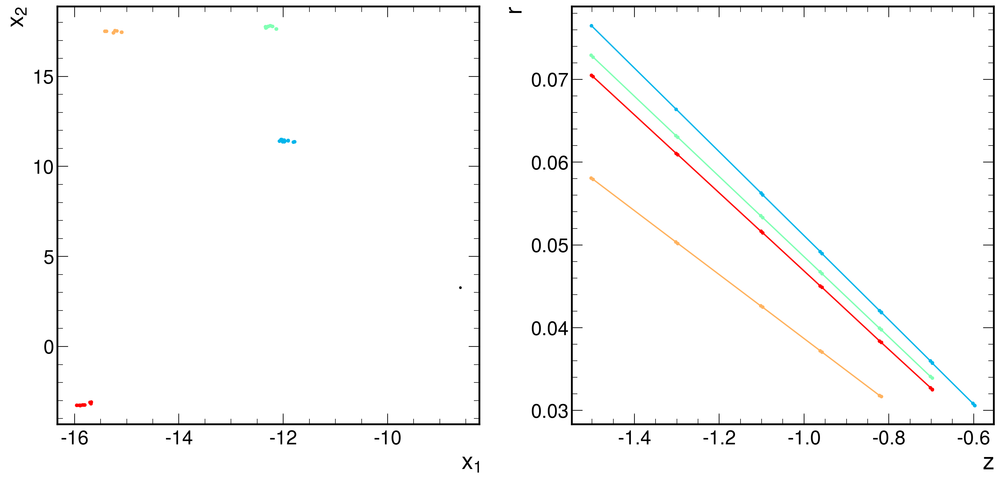

('../graphs/train1_ptmin1/event000001104_s59.npz',)
analyzing sector 59
condensation loss 0.0013124418910592794
edge weight loss tensor(0.0046)
condensation loss tensor(0.0013)
number of particles 29
number of tracks: 27
number of labels: 28
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


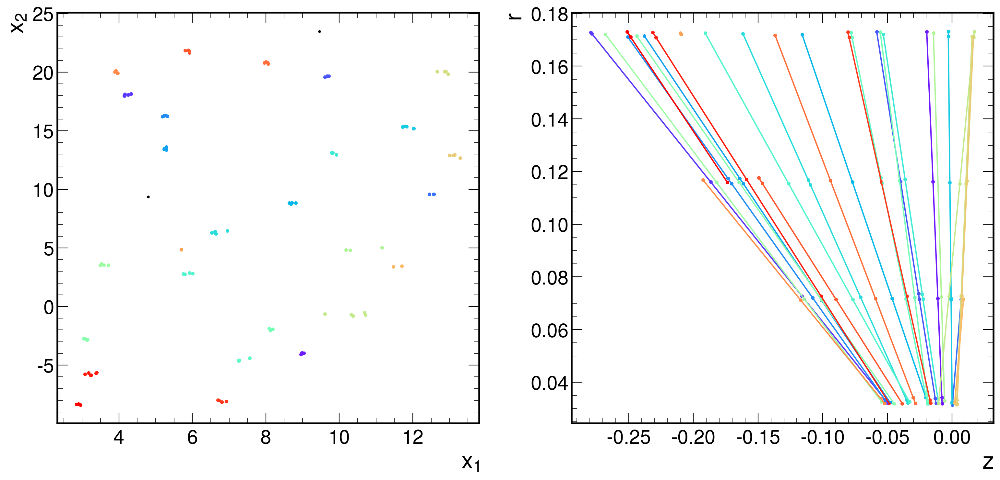

('../graphs/train1_ptmin1/event000001104_s51.npz',)
analyzing sector 51
condensation loss 0.008452803827822208
edge weight loss tensor(0.0122)
condensation loss tensor(0.0085)
number of particles 47
number of tracks: 46
number of labels: 51
perfect match fraction: 0.8478260869565217
double majority fraction: 0.9347826086956522
lhc loose fraction: 0.8913043478260869


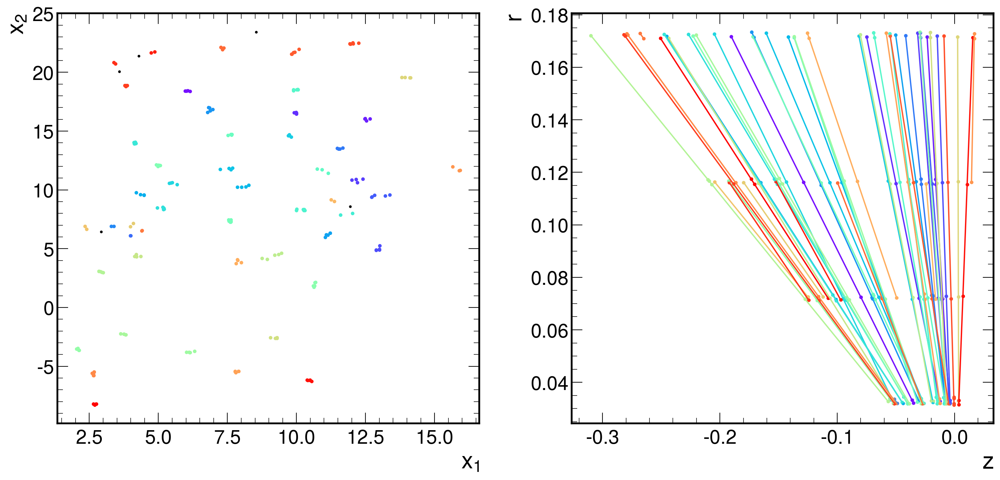

('../graphs/train1_ptmin1/event000001104_s31.npz',)
analyzing sector 31
condensation loss 0.00037776774843223393
edge weight loss tensor(0.0004)
condensation loss tensor(0.0004)
number of particles 4
number of tracks: 4
number of labels: 4
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


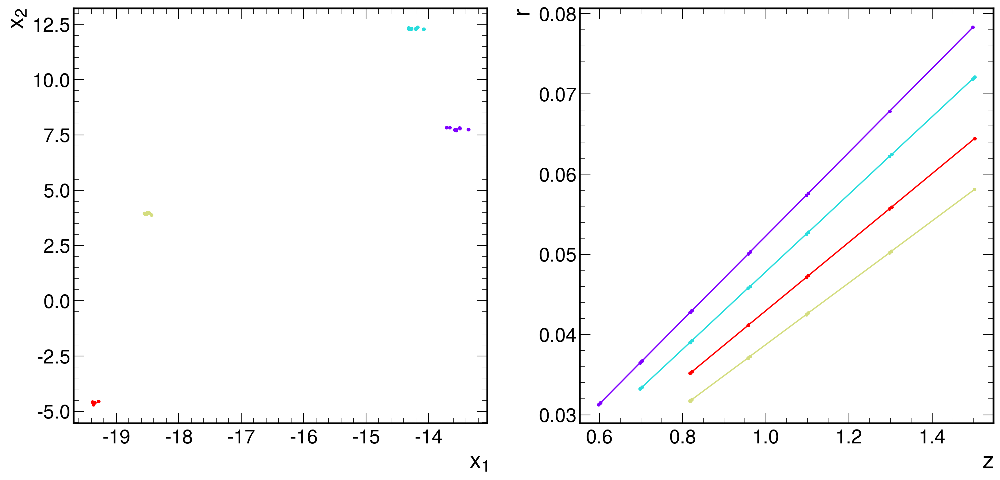

('../graphs/train1_ptmin1/event000001104_s34.npz',)
analyzing sector 34
condensation loss 0.0081693259999156
edge weight loss tensor(0.0179)
condensation loss tensor(0.0082)
number of particles 29
number of tracks: 27
number of labels: 30
perfect match fraction: 0.7777777777777778
double majority fraction: 0.9629629629629629
lhc loose fraction: 0.8148148148148148


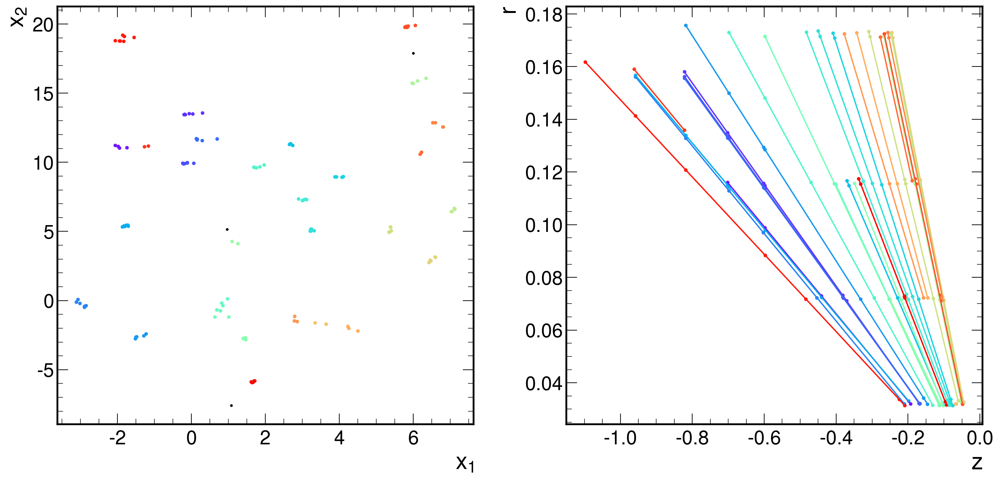

('../graphs/train1_ptmin1/event000001104_s42.npz',)
analyzing sector 42
condensation loss 0.019655577838420868
edge weight loss tensor(0.0336)
condensation loss tensor(0.0197)
number of particles 27
number of tracks: 26
number of labels: 29
perfect match fraction: 0.6923076923076923
double majority fraction: 0.9615384615384616
lhc loose fraction: 0.8846153846153846


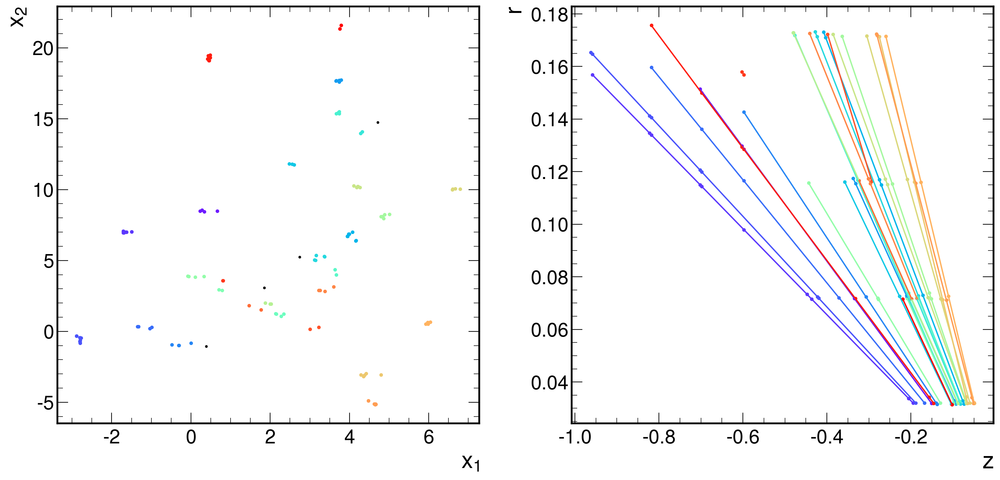

('../graphs/train1_ptmin1/event000001104_s20.npz',)
analyzing sector 20
condensation loss 0.002512257546186447
edge weight loss tensor(0.0079)
condensation loss tensor(0.0025)
number of particles 29
number of tracks: 26
number of labels: 27
perfect match fraction: 0.9230769230769231
double majority fraction: 1.0
lhc loose fraction: 0.9230769230769231


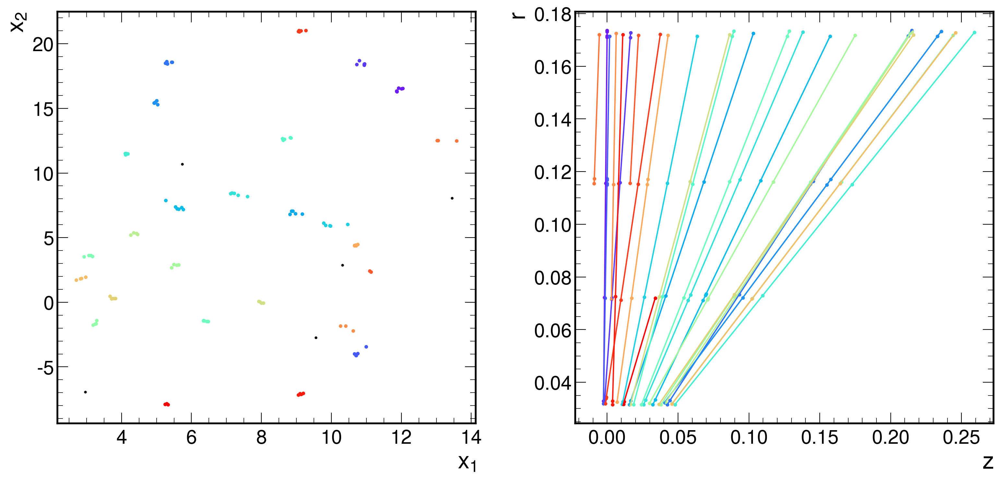

('../graphs/train1_ptmin1/event000001104_s11.npz',)
analyzing sector 11
condensation loss 0.01136293075978756
edge weight loss tensor(0.0253)
condensation loss tensor(0.0114)
number of particles 36
number of tracks: 33
number of labels: 34
perfect match fraction: 0.9393939393939394
double majority fraction: 0.9696969696969697
lhc loose fraction: 0.9696969696969697


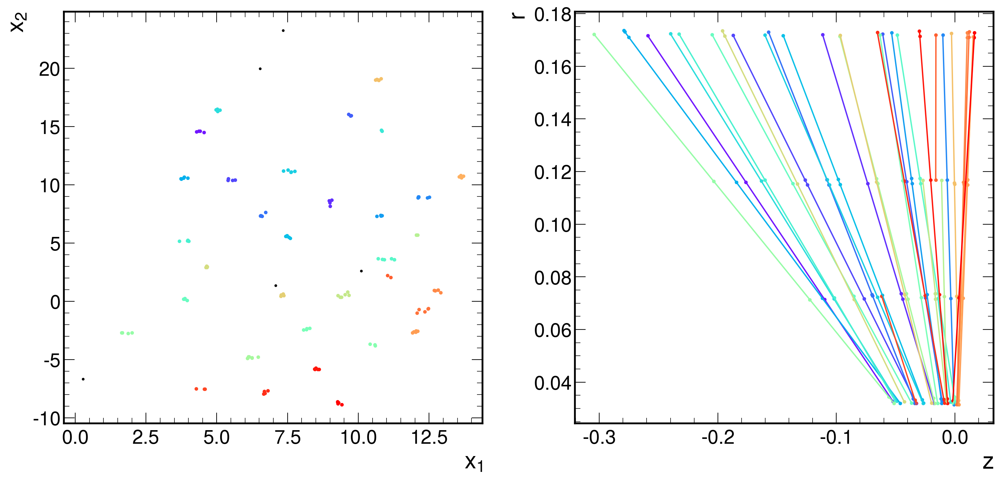

('../graphs/train1_ptmin1/event000001104_s47.npz',)
analyzing sector 47
condensation loss 0.000677370117045939
edge weight loss tensor(0.0007)
condensation loss tensor(0.0007)
number of particles 6
number of tracks: 6
number of labels: 7
perfect match fraction: 0.8333333333333334
double majority fraction: 1.0
lhc loose fraction: 1.0


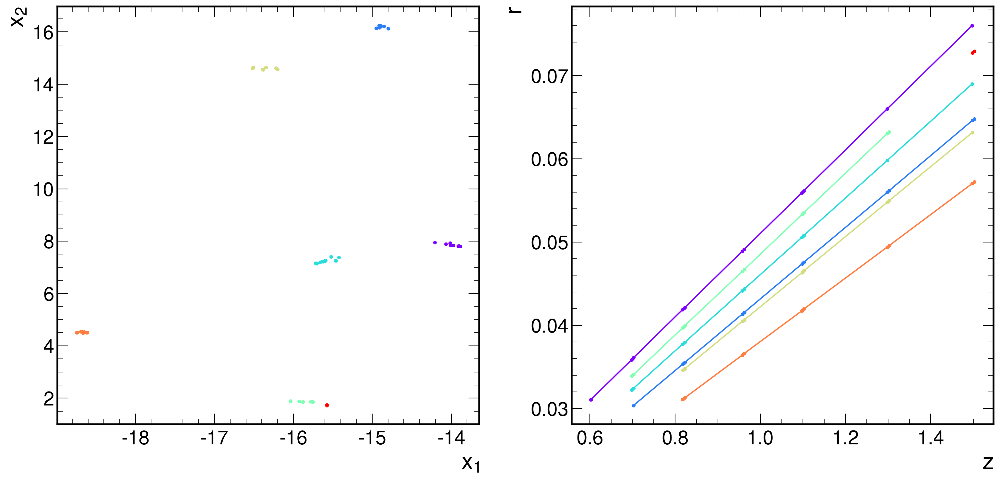

('../graphs/train1_ptmin1/event000001104_s3.npz',)
analyzing sector 3
condensation loss 0.008142901584506035
edge weight loss tensor(0.0125)
condensation loss tensor(0.0081)
number of particles 31
number of tracks: 30
number of labels: 32
perfect match fraction: 0.9
double majority fraction: 0.9666666666666667
lhc loose fraction: 0.9333333333333333


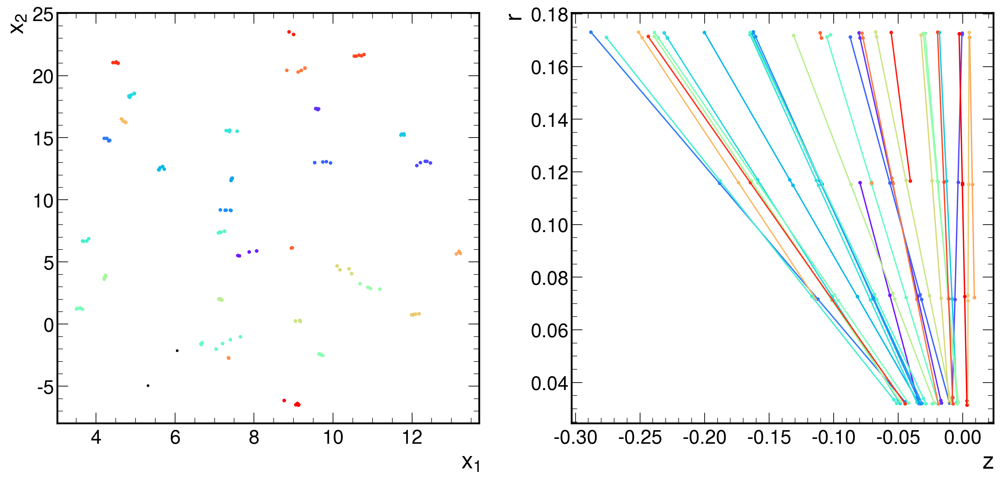

('../graphs/train1_ptmin1/event000001104_s52.npz',)
analyzing sector 52
condensation loss 0.0023545066360384226
edge weight loss tensor(0.0035)
condensation loss tensor(0.0024)
number of particles 24
number of tracks: 24
number of labels: 26
perfect match fraction: 0.9166666666666666
double majority fraction: 0.9583333333333334
lhc loose fraction: 0.9583333333333334


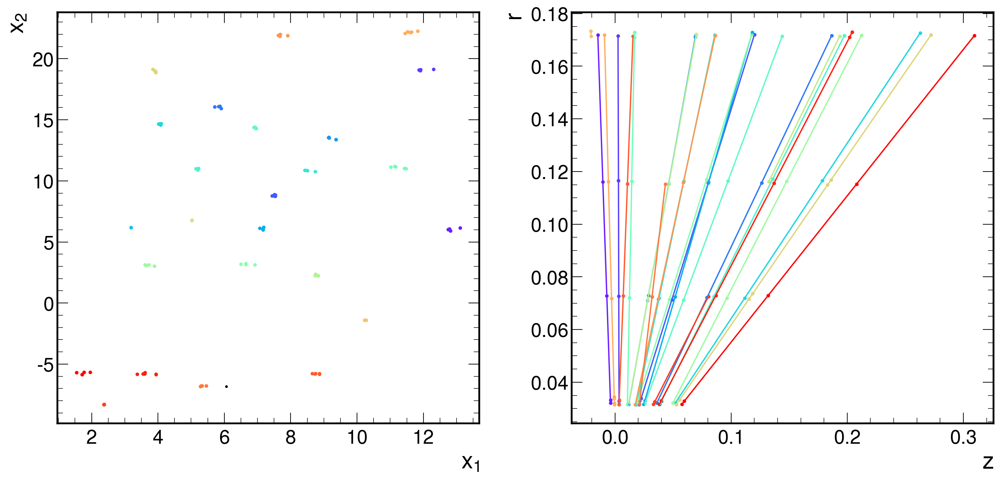

('../graphs/train1_ptmin1/event000001104_s19.npz',)
analyzing sector 19
condensation loss 0.012680457904934883
edge weight loss tensor(0.0188)
condensation loss tensor(0.0127)
number of particles 41
number of tracks: 40
number of labels: 41
perfect match fraction: 0.875
double majority fraction: 0.975
lhc loose fraction: 0.95


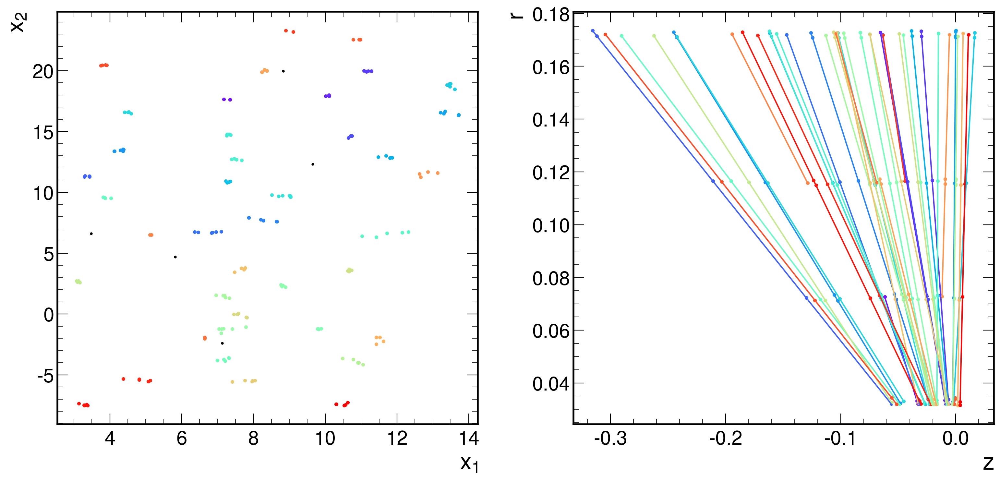

('../graphs/train1_ptmin1/event000001104_s60.npz',)
analyzing sector 60
condensation loss 0.01536624040454626
edge weight loss tensor(0.0283)
condensation loss tensor(0.0154)
number of particles 43
number of tracks: 40
number of labels: 38
perfect match fraction: 0.675
double majority fraction: 0.875
lhc loose fraction: 0.8


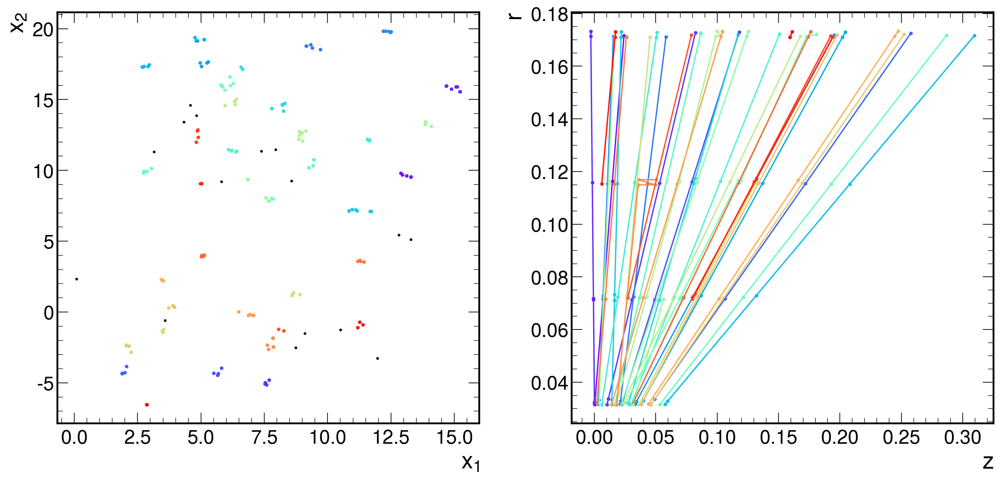

('../graphs/train1_ptmin1/event000001104_s28.npz',)
analyzing sector 28
condensation loss 0.01671179011464119
edge weight loss tensor(0.0315)
condensation loss tensor(0.0167)
number of particles 32
number of tracks: 31
number of labels: 32
perfect match fraction: 0.7419354838709677
double majority fraction: 0.9354838709677419
lhc loose fraction: 0.9032258064516129


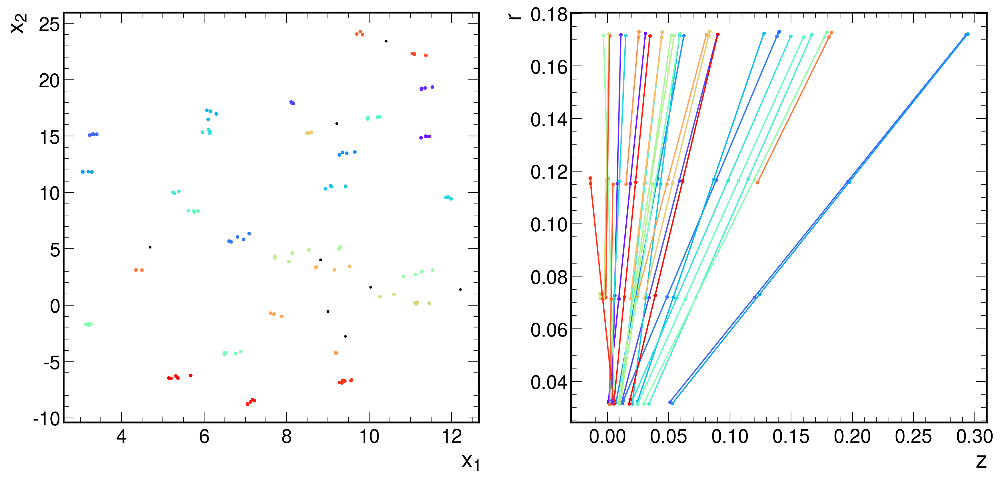

('../graphs/train1_ptmin1/event000001104_s17.npz',)
analyzing sector 17
condensation loss 0.004393391776829958
edge weight loss tensor(0.0167)
condensation loss tensor(0.0044)
number of particles 24
number of tracks: 24
number of labels: 26
perfect match fraction: 0.875
double majority fraction: 1.0
lhc loose fraction: 0.9166666666666666


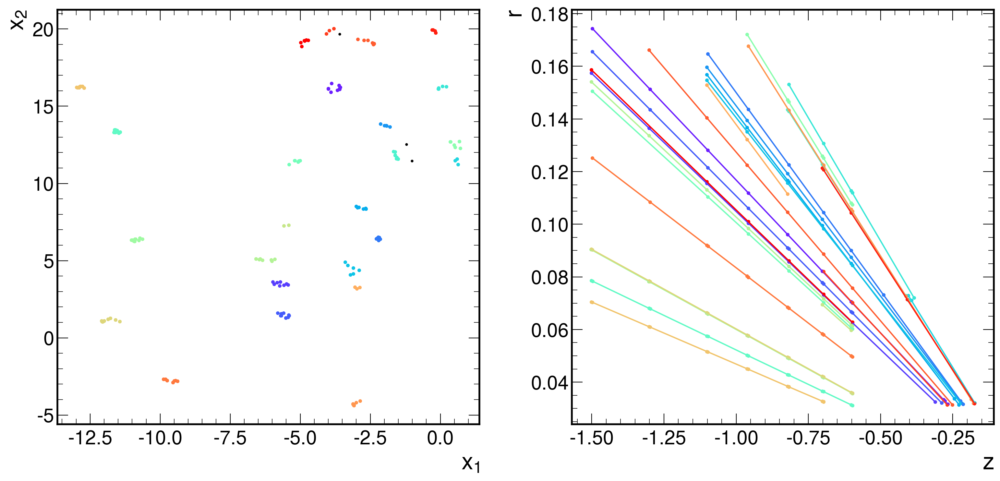

('../graphs/train1_ptmin1/event000001104_s25.npz',)
analyzing sector 25
condensation loss 0.0014837696217000484
edge weight loss tensor(0.0016)
condensation loss tensor(0.0015)
number of particles 21
number of tracks: 20
number of labels: 23
perfect match fraction: 0.9
double majority fraction: 1.0
lhc loose fraction: 0.9


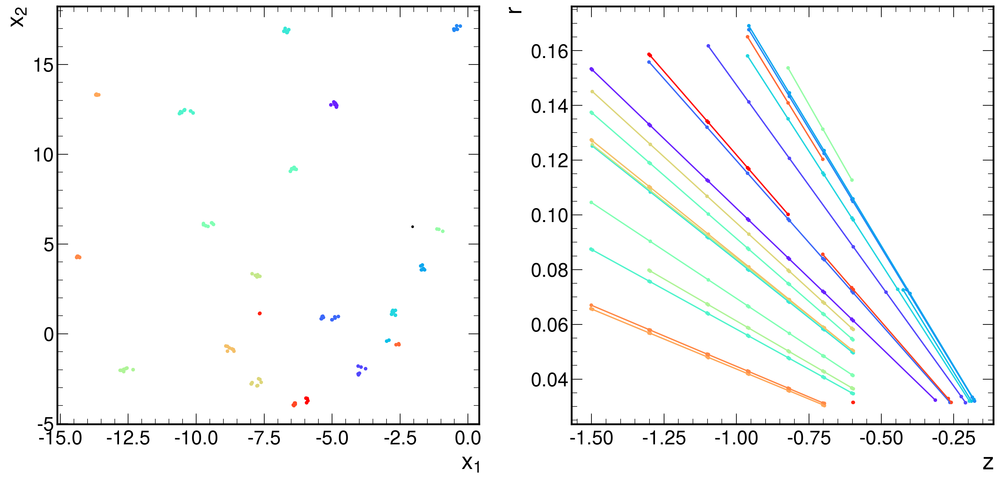

('../graphs/train1_ptmin1/event000001104_s46.npz',)
analyzing sector 46
condensation loss 0.014584817923605442
edge weight loss tensor(0.0200)
condensation loss tensor(0.0146)
number of particles 26
number of tracks: 26
number of labels: 34
perfect match fraction: 0.6923076923076923
double majority fraction: 0.9615384615384616
lhc loose fraction: 0.7692307692307693


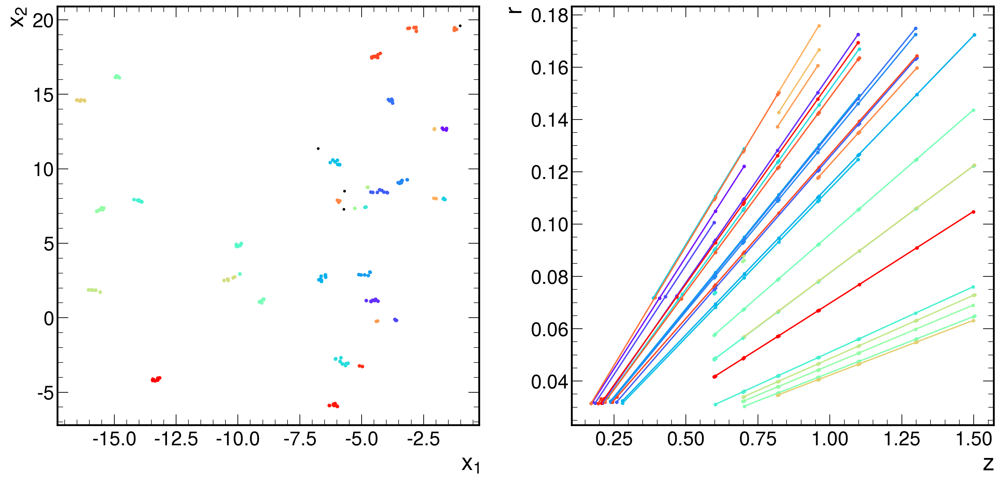

('../graphs/train1_ptmin1/event000001104_s53.npz',)
analyzing sector 53
condensation loss 0.009083460085093975
edge weight loss tensor(0.0318)
condensation loss tensor(0.0091)
number of particles 28
number of tracks: 26
number of labels: 30
perfect match fraction: 0.7307692307692307
double majority fraction: 1.0
lhc loose fraction: 0.8461538461538461


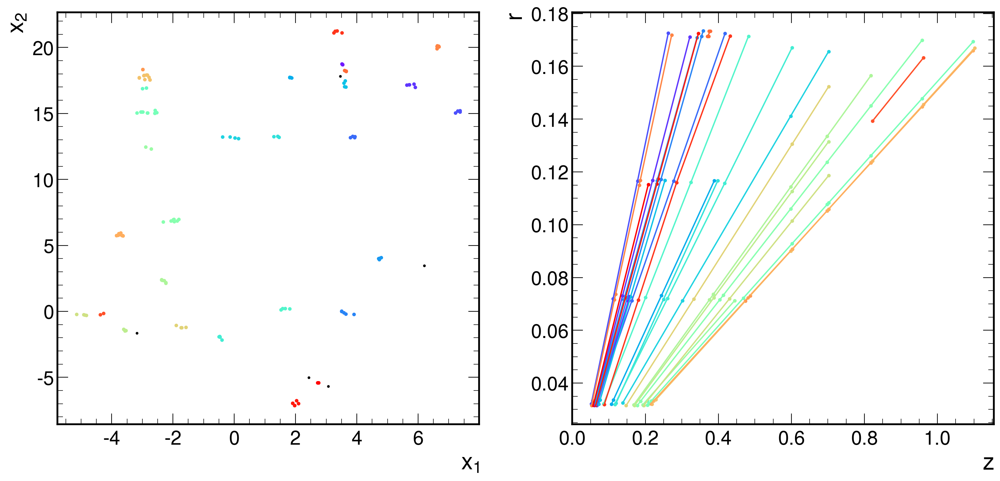

('../graphs/train1_ptmin1/event000001104_s63.npz',)
analyzing sector 63
condensation loss 0.00032325793290510774
edge weight loss tensor(0.0004)
condensation loss tensor(0.0003)
number of particles 5
number of tracks: 4
number of labels: 5
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


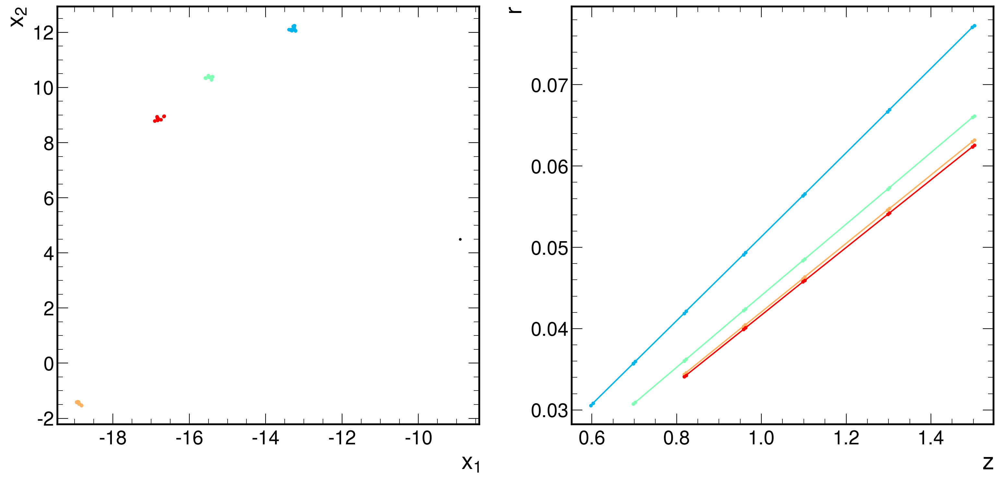

('../graphs/train1_ptmin1/event000001104_s13.npz',)
analyzing sector 13
condensation loss 0.0013072520960122347
edge weight loss tensor(0.0067)
condensation loss tensor(0.0013)
number of particles 37
number of tracks: 36
number of labels: 39
perfect match fraction: 0.8888888888888888
double majority fraction: 0.9722222222222222
lhc loose fraction: 0.9166666666666666


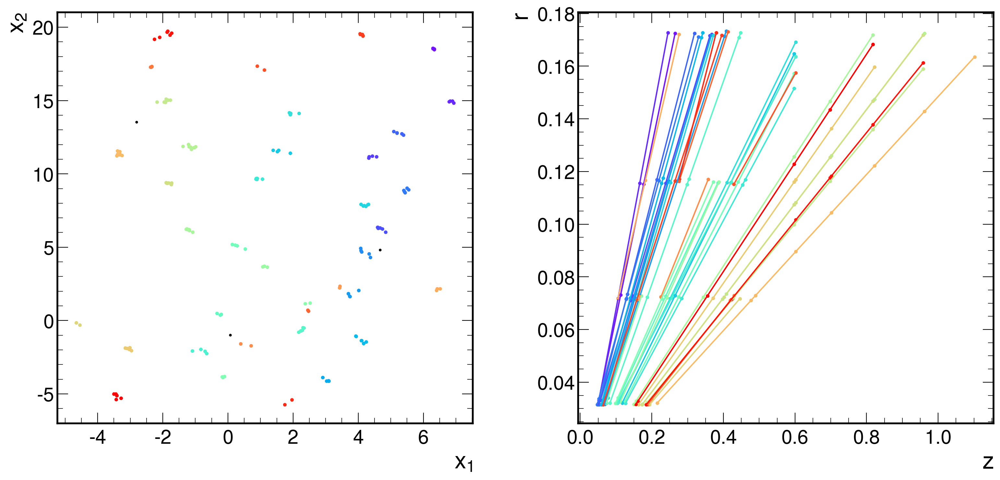

('../graphs/train1_ptmin1/event000001104_s41.npz',)
analyzing sector 41
condensation loss 0.0023392685689032078
edge weight loss tensor(0.0026)
condensation loss tensor(0.0023)
number of particles 24
number of tracks: 24
number of labels: 28
perfect match fraction: 0.7083333333333334
double majority fraction: 0.9583333333333334
lhc loose fraction: 0.875


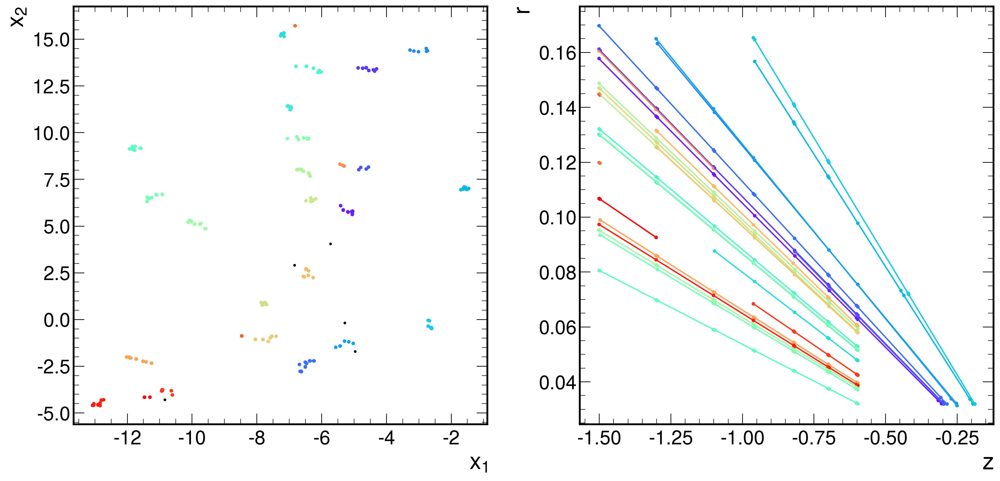

('../graphs/train1_ptmin1/event000001104_s22.npz',)
analyzing sector 22
condensation loss 0.007903519086539745
edge weight loss tensor(0.0081)
condensation loss tensor(0.0079)
number of particles 30
number of tracks: 30
number of labels: 32
perfect match fraction: 0.8333333333333334
double majority fraction: 0.8666666666666667
lhc loose fraction: 0.9


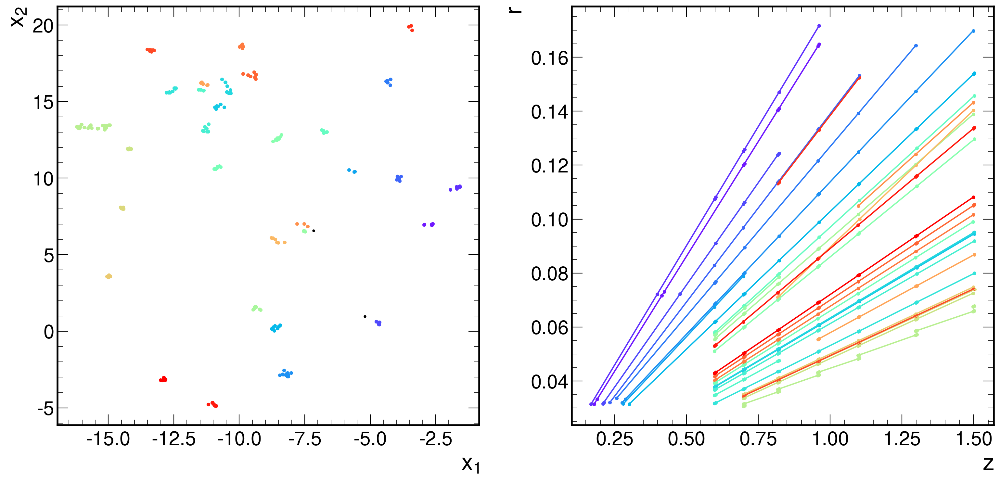

('../graphs/train1_ptmin1/event000001104_s50.npz',)
analyzing sector 50
condensation loss 0.02531220018863678
edge weight loss tensor(0.0349)
condensation loss tensor(0.0253)
number of particles 48
number of tracks: 43
number of labels: 35
perfect match fraction: 0.5813953488372093
double majority fraction: 0.7209302325581395
lhc loose fraction: 0.7674418604651163


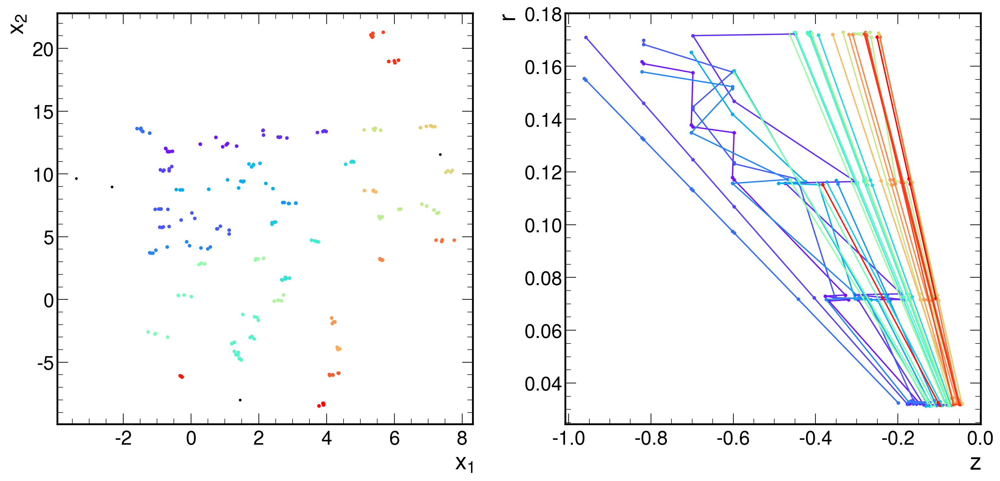

('../graphs/train1_ptmin1/event000001104_s58.npz',)
analyzing sector 58
condensation loss 0.029198747128248215
edge weight loss tensor(0.0468)
condensation loss tensor(0.0292)
number of particles 47
number of tracks: 47
number of labels: 45
perfect match fraction: 0.8085106382978723
double majority fraction: 0.851063829787234
lhc loose fraction: 0.8723404255319149


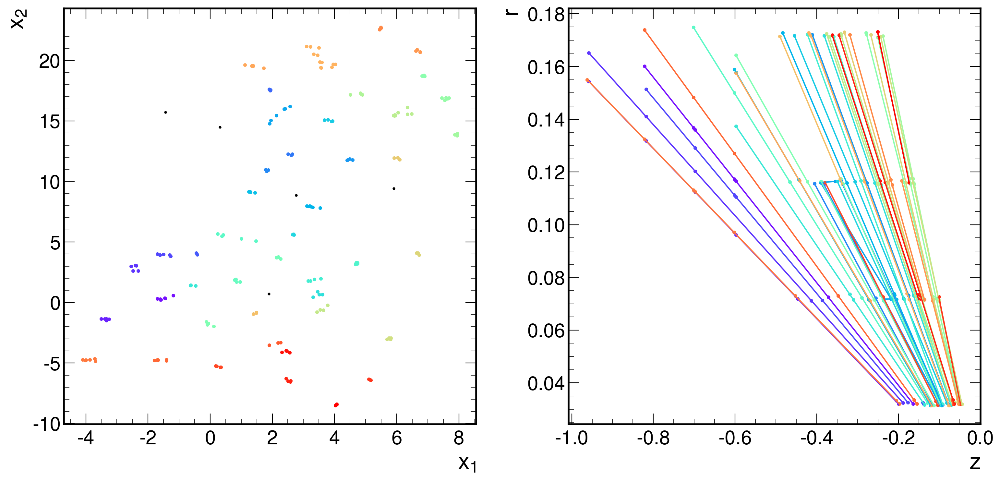

('../graphs/train1_ptmin1/event000001104_s23.npz',)
analyzing sector 23
condensation loss 0.015425432473421097
edge weight loss tensor(0.0155)
condensation loss tensor(0.0154)
number of particles 10
number of tracks: 10
number of labels: 11
perfect match fraction: 0.9
double majority fraction: 1.0
lhc loose fraction: 1.0


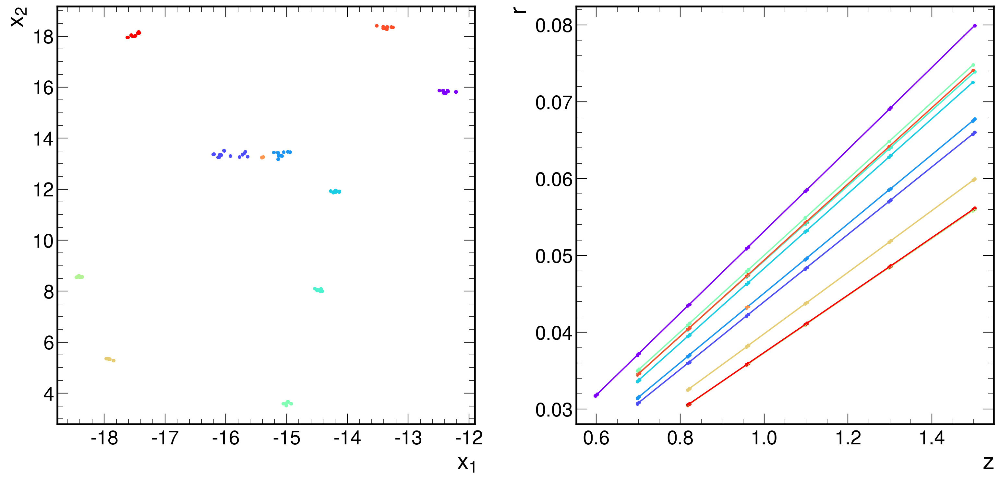

('../graphs/train1_ptmin1/event000001104_s0.npz',)
analyzing sector 0
condensation loss 0.0028582417871803045
edge weight loss tensor(0.0039)
condensation loss tensor(0.0029)
number of particles 5
number of tracks: 5
number of labels: 6
perfect match fraction: 0.8
double majority fraction: 1.0
lhc loose fraction: 0.8


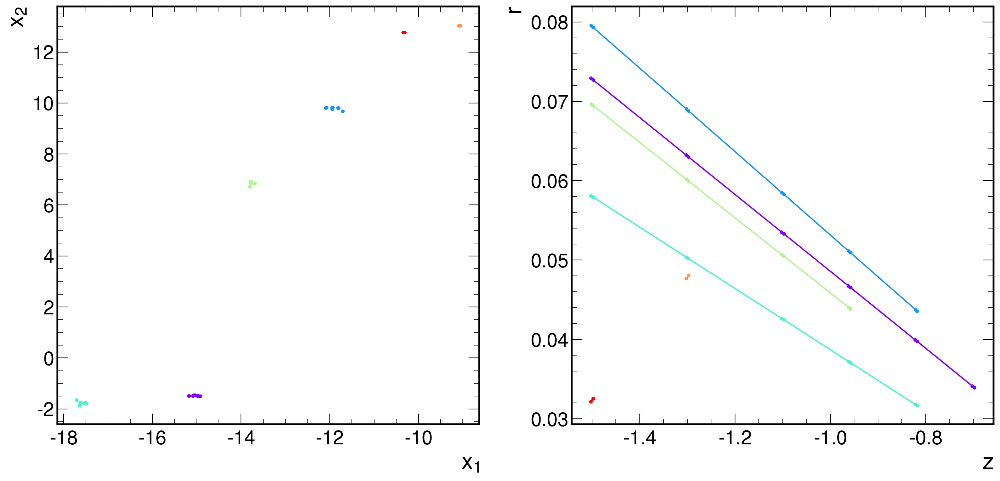

('../graphs/train1_ptmin1/event000001104_s49.npz',)
analyzing sector 49
condensation loss 0.0015755690401419997
edge weight loss tensor(0.0017)
condensation loss tensor(0.0016)
number of particles 26
number of tracks: 24
number of labels: 27
perfect match fraction: 0.9166666666666666
double majority fraction: 1.0
lhc loose fraction: 0.9583333333333334


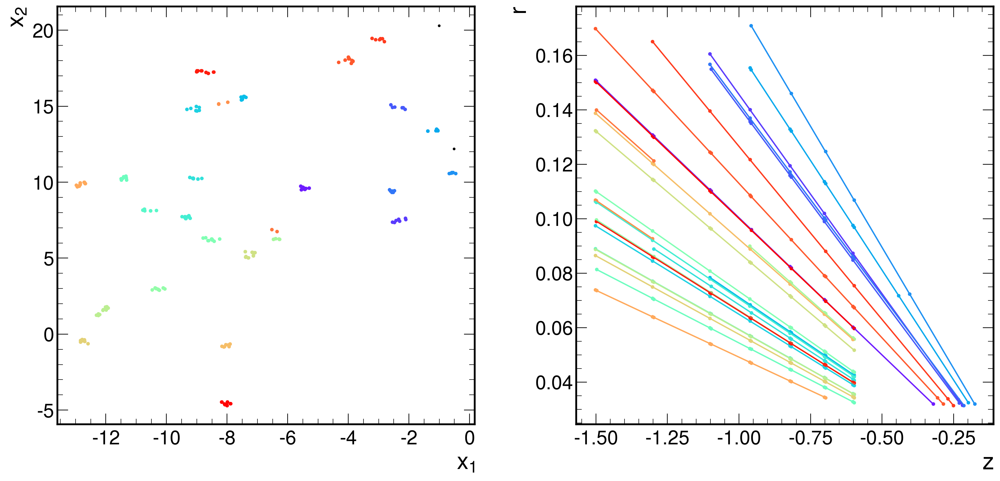

('../graphs/train1_ptmin1/event000001104_s16.npz',)
analyzing sector 16
condensation loss 0.00045303540537133813
edge weight loss tensor(0.0005)
condensation loss tensor(0.0005)
number of particles 4
number of tracks: 3
number of labels: 4
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


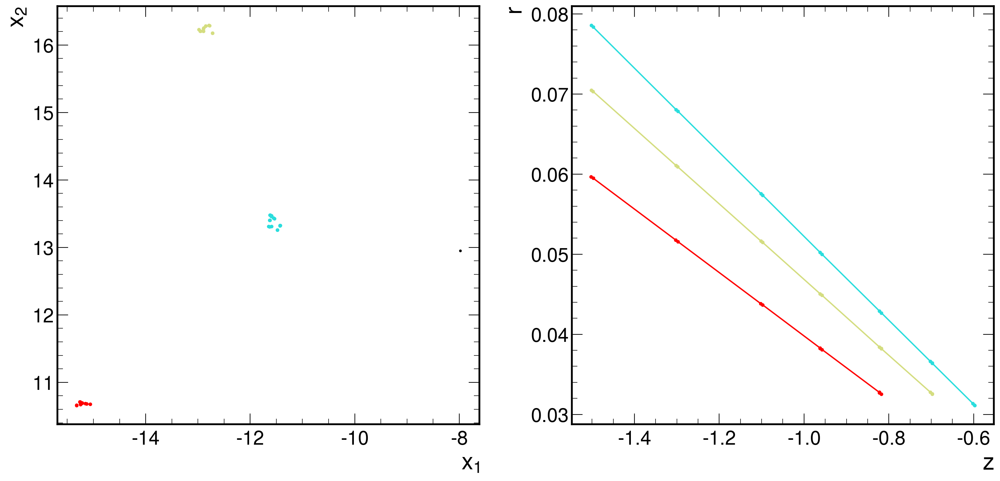

('../graphs/train1_ptmin1/event000001104_s5.npz',)
analyzing sector 5
condensation loss 0.021195407956838608
edge weight loss tensor(0.0368)
condensation loss tensor(0.0212)
number of particles 45
number of tracks: 44
number of labels: 47
perfect match fraction: 0.6818181818181818
double majority fraction: 0.8409090909090909
lhc loose fraction: 0.7727272727272727


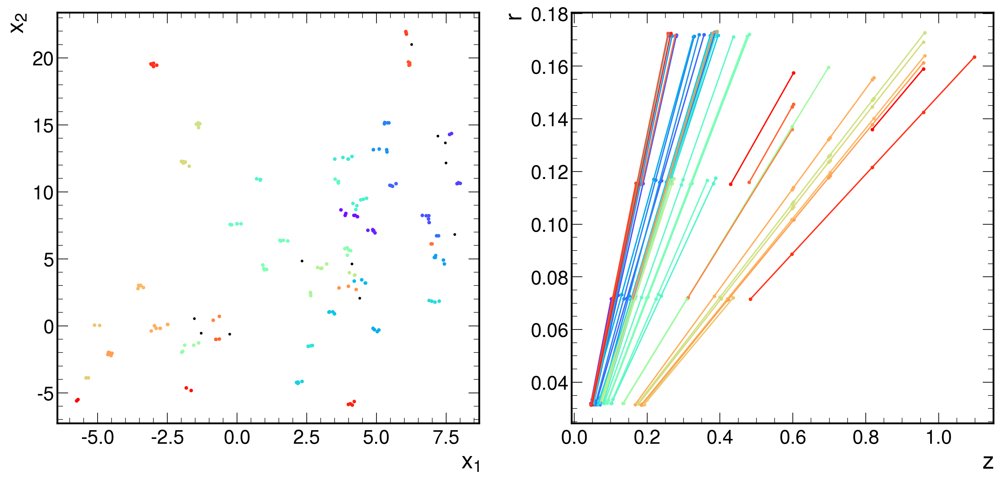

('../graphs/train1_ptmin1/event000001104_s24.npz',)
analyzing sector 24
condensation loss 0.00033817533403635025
edge weight loss tensor(0.0005)
condensation loss tensor(0.0003)
number of particles 4
number of tracks: 4
number of labels: 4
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


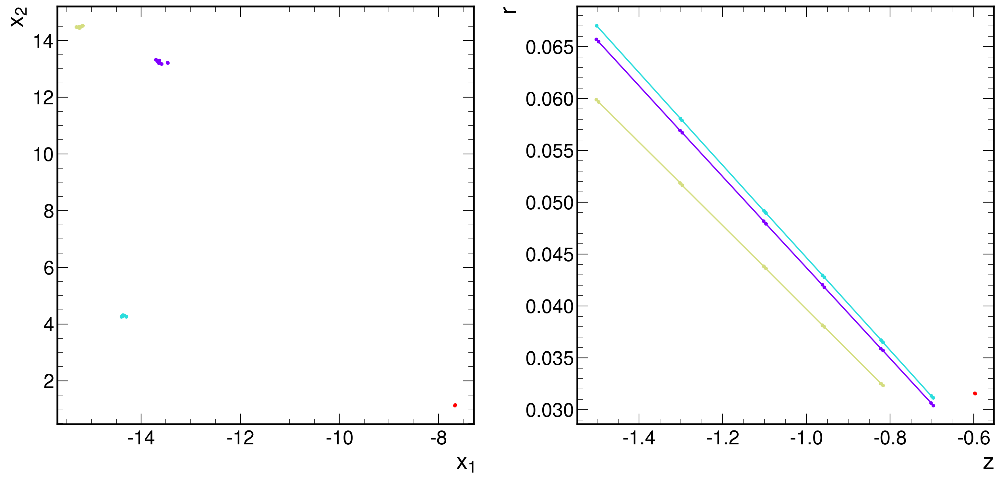

('../graphs/train1_ptmin1/event000001104_s2.npz',)
analyzing sector 2
condensation loss 0.005637964233756065
edge weight loss tensor(0.0212)
condensation loss tensor(0.0056)
number of particles 37
number of tracks: 37
number of labels: 35
perfect match fraction: 0.8918918918918919
double majority fraction: 0.8918918918918919
lhc loose fraction: 0.9459459459459459


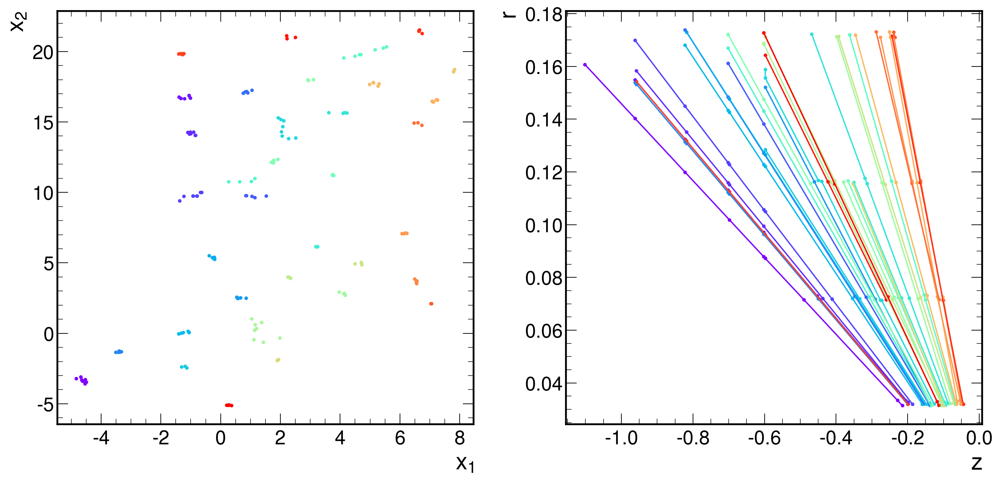

('../graphs/train1_ptmin1/event000001104_s36.npz',)
analyzing sector 36
condensation loss 0.0057432991452515125
edge weight loss tensor(0.0141)
condensation loss tensor(0.0057)
number of particles 33
number of tracks: 31
number of labels: 32
perfect match fraction: 0.8387096774193549
double majority fraction: 1.0
lhc loose fraction: 0.9032258064516129


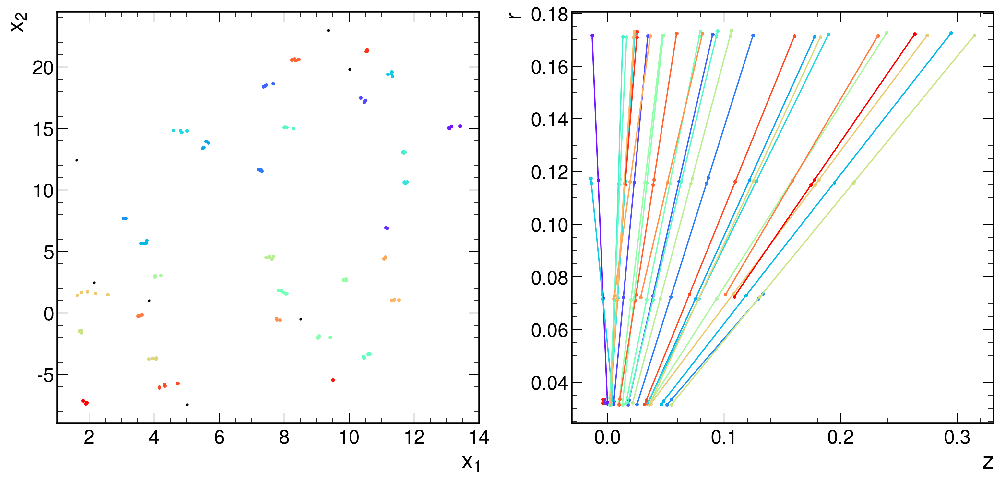

('../graphs/train1_ptmin1/event000001104_s15.npz',)
analyzing sector 15
condensation loss 0.00012013618106720969
edge weight loss tensor(0.0001)
condensation loss tensor(0.0001)
number of particles 8
number of tracks: 8
number of labels: 8
perfect match fraction: 1.0
double majority fraction: 1.0
lhc loose fraction: 1.0


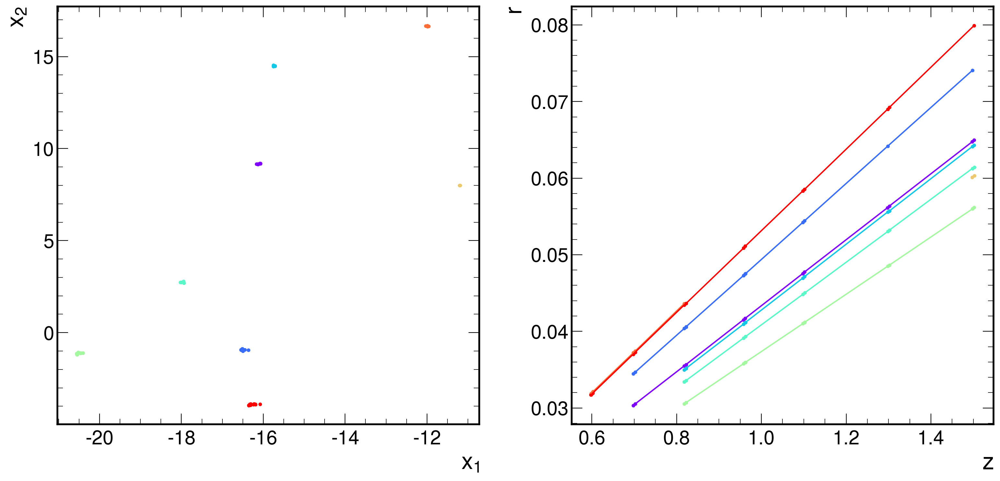

('../graphs/train1_ptmin1/event000001104_s18.npz',)
analyzing sector 18
condensation loss 0.004479491151869297
edge weight loss tensor(0.0172)
condensation loss tensor(0.0045)
number of particles 27
number of tracks: 26
number of labels: 28
perfect match fraction: 0.8076923076923077
double majority fraction: 0.9230769230769231
lhc loose fraction: 0.9230769230769231


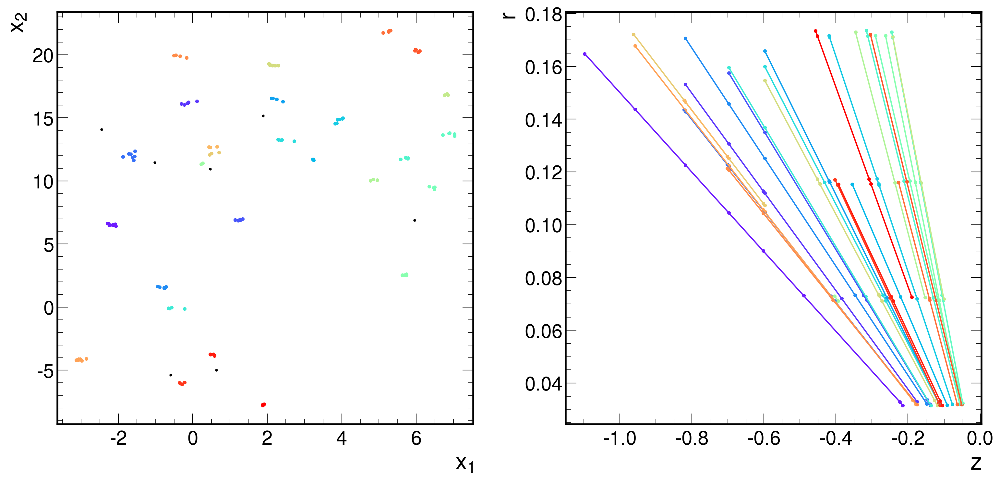

('../graphs/train1_ptmin1/event000001104_s7.npz',)
analyzing sector 7
condensation loss 0.00047123045078478754
edge weight loss tensor(0.0005)
condensation loss tensor(0.0005)
number of particles 11
number of tracks: 10
number of labels: 12
perfect match fraction: 0.9
double majority fraction: 1.0
lhc loose fraction: 1.0


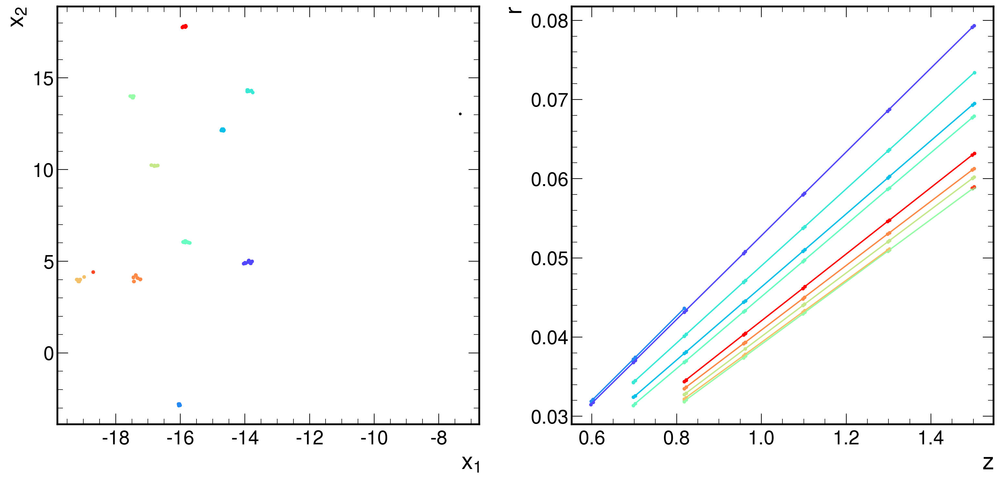

('../graphs/train1_ptmin1/event000001104_s54.npz',)
analyzing sector 54
condensation loss 0.0008798050112091005
edge weight loss tensor(0.0016)
condensation loss tensor(0.0009)
number of particles 26
number of tracks: 26
number of labels: 31
perfect match fraction: 0.8076923076923077
double majority fraction: 1.0
lhc loose fraction: 0.9615384615384616


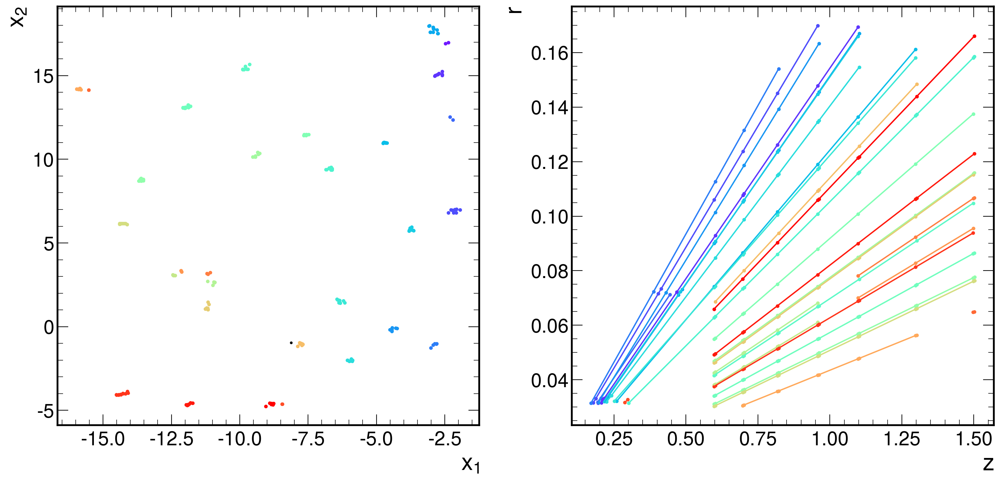

('../graphs/train1_ptmin1/event000001104_s30.npz',)
analyzing sector 30
condensation loss 0.004228653386235237
edge weight loss tensor(0.0244)
condensation loss tensor(0.0042)
number of particles 29
number of tracks: 28
number of labels: 32
perfect match fraction: 0.7857142857142857
double majority fraction: 0.8928571428571429
lhc loose fraction: 0.8928571428571429


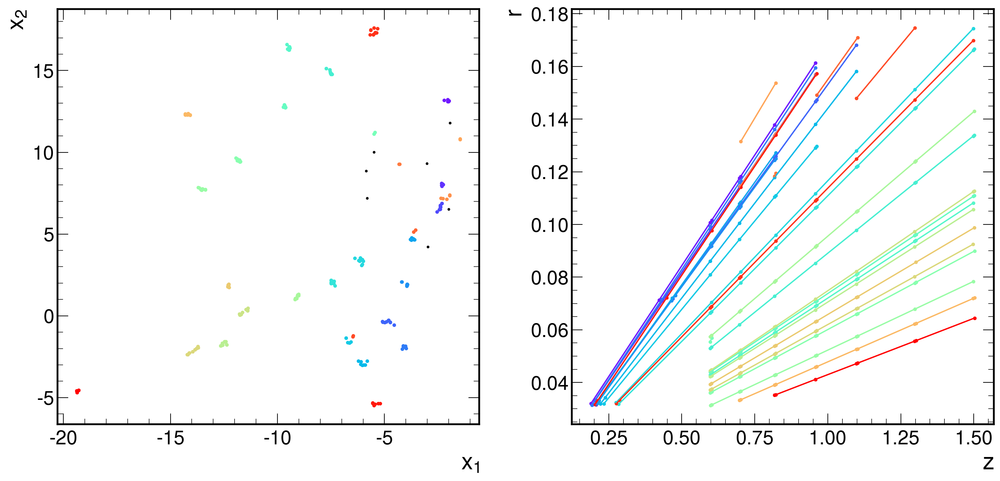

('../graphs/train1_ptmin1/event000001104_s61.npz',)
analyzing sector 61
condensation loss 0.002497388981282711
edge weight loss tensor(0.0076)
condensation loss tensor(0.0025)
number of particles 26
number of tracks: 25
number of labels: 25
perfect match fraction: 0.88
double majority fraction: 0.96
lhc loose fraction: 0.96


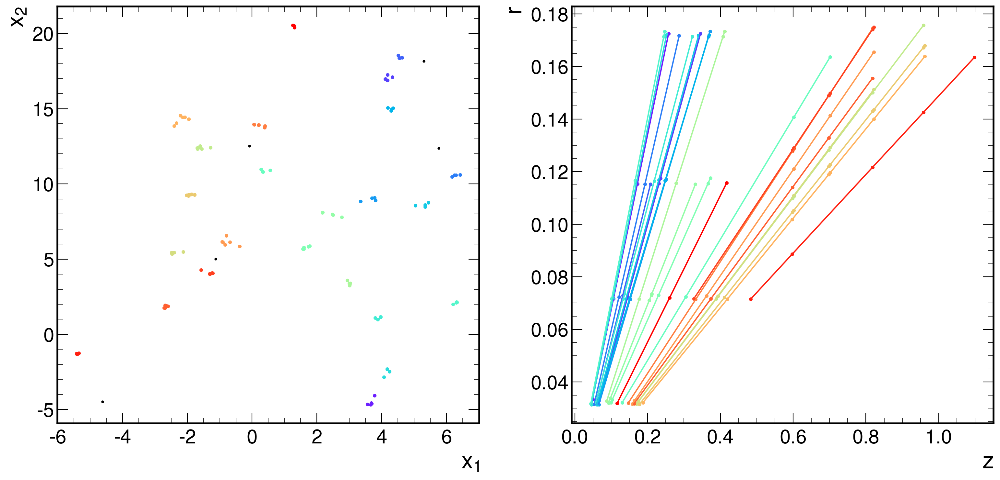

('../graphs/train1_ptmin1/event000001104_s57.npz',)
analyzing sector 57
condensation loss 0.008550925180315971
edge weight loss tensor(0.0086)
condensation loss tensor(0.0086)
number of particles 25
number of tracks: 24
number of labels: 31
perfect match fraction: 0.6666666666666666
double majority fraction: 1.0
lhc loose fraction: 0.75


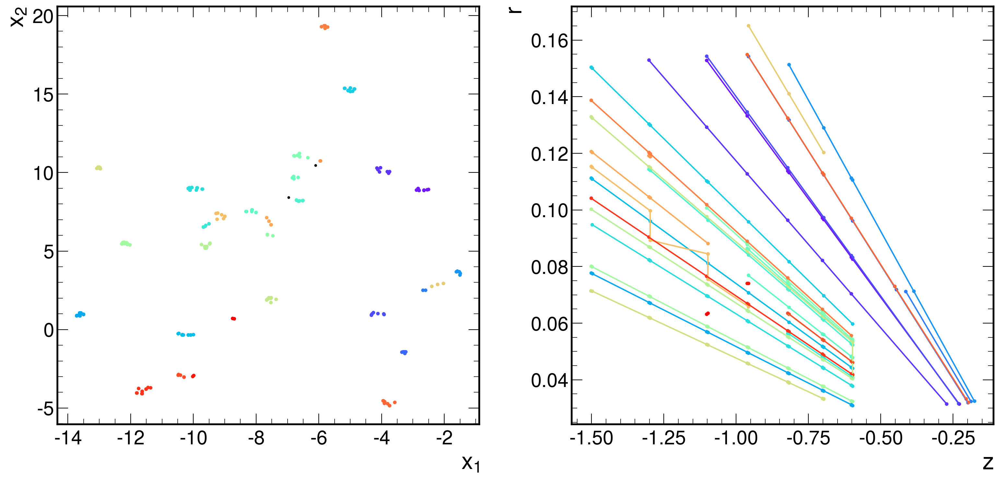

('../graphs/train1_ptmin1/event000001104_s39.npz',)
analyzing sector 39
condensation loss 0.0004528916615527123
edge weight loss tensor(0.0005)
condensation loss tensor(0.0005)
number of particles 11
number of tracks: 10
number of labels: 12
perfect match fraction: 0.9
double majority fraction: 1.0
lhc loose fraction: 1.0


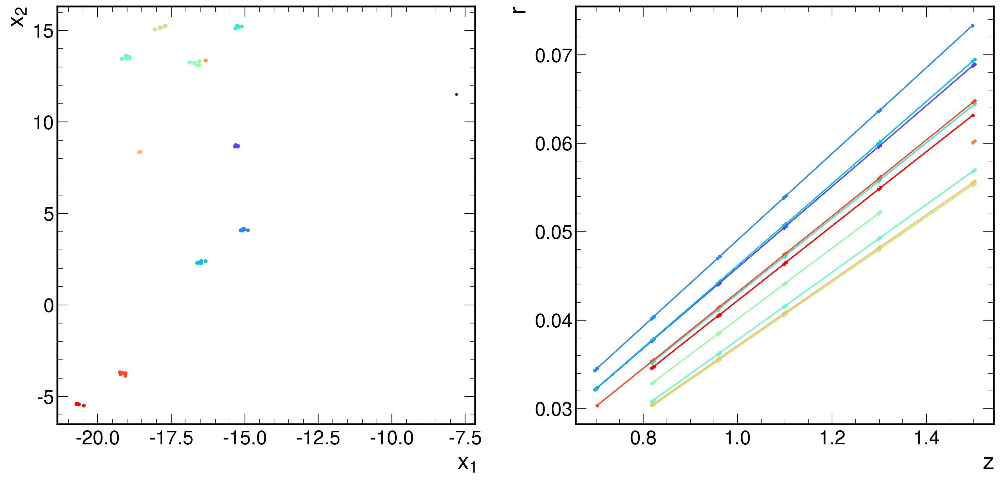

('../graphs/train1_ptmin1/event000001104_s35.npz',)
analyzing sector 35
condensation loss 0.007548769004642963
edge weight loss tensor(0.0186)
condensation loss tensor(0.0075)
number of particles 39
number of tracks: 37
number of labels: 40
perfect match fraction: 0.7837837837837838
double majority fraction: 0.8648648648648649
lhc loose fraction: 0.8378378378378378


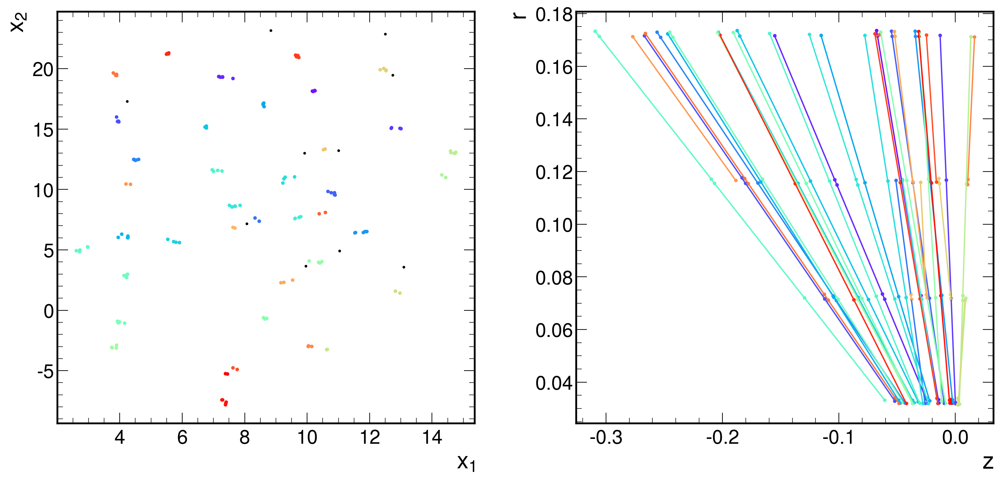

('../graphs/train1_ptmin1/event000001104_s45.npz',)
analyzing sector 45
condensation loss 0.012485775165259838
edge weight loss tensor(0.0257)
condensation loss tensor(0.0125)
number of particles 45
number of tracks: 45
number of labels: 52
perfect match fraction: 0.6
double majority fraction: 0.9555555555555556
lhc loose fraction: 0.7333333333333333


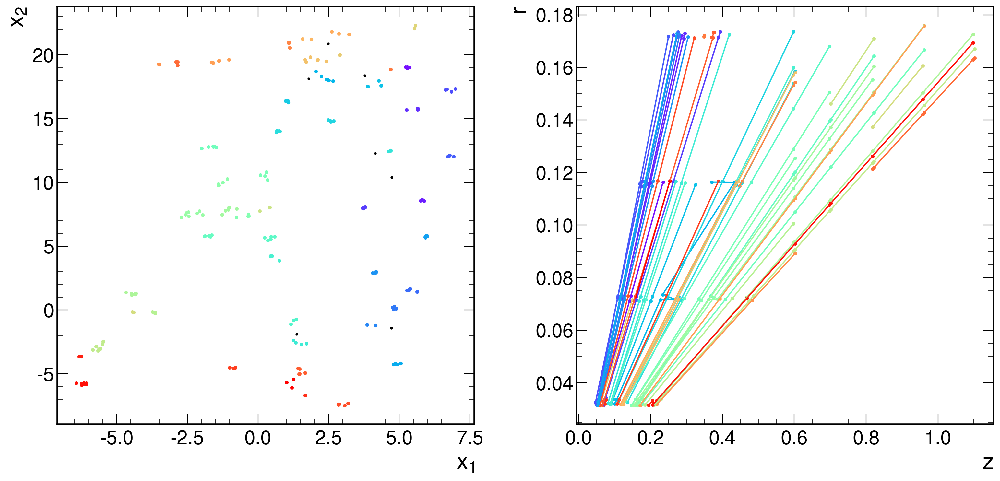

('../graphs/train1_ptmin1/event000001104_s4.npz',)
analyzing sector 4
condensation loss 0.009043526835739613
edge weight loss tensor(0.0174)
condensation loss tensor(0.0090)
number of particles 48
number of tracks: 44
number of labels: 49
perfect match fraction: 0.7045454545454546
double majority fraction: 0.9318181818181818
lhc loose fraction: 0.8181818181818182


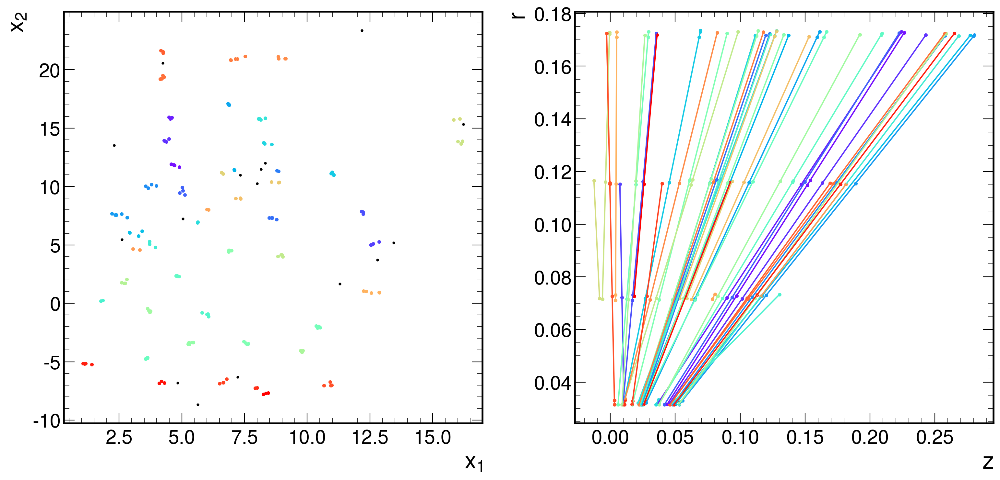

('../graphs/train1_ptmin1/event000001104_s62.npz',)
analyzing sector 62
condensation loss 0.004573915619403124
edge weight loss tensor(0.0071)
condensation loss tensor(0.0046)
number of particles 35
number of tracks: 34
number of labels: 38
perfect match fraction: 0.7647058823529411
double majority fraction: 0.9411764705882353
lhc loose fraction: 0.8823529411764706


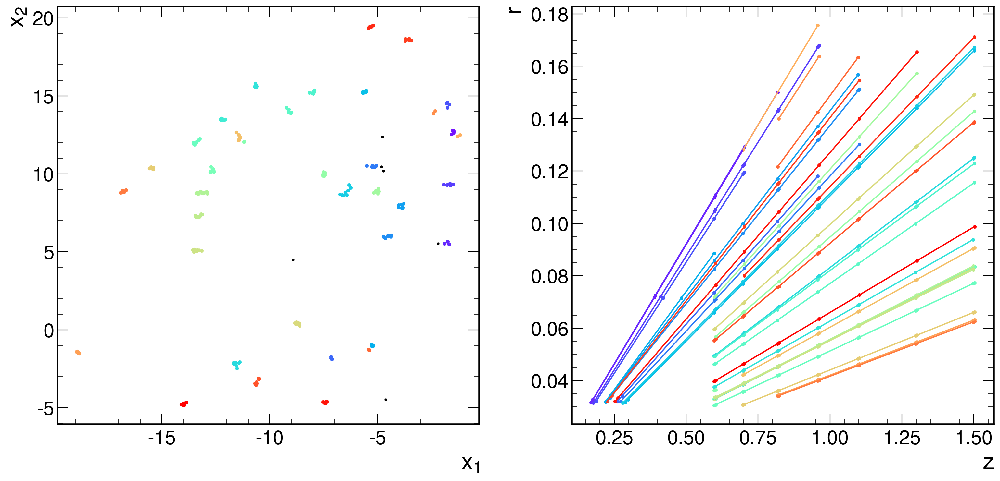

('../graphs/train1_ptmin1/event000001104_s9.npz',)
analyzing sector 9
condensation loss 0.002361518796533346
edge weight loss tensor(0.0040)
condensation loss tensor(0.0024)
number of particles 30
number of tracks: 29
number of labels: 35
perfect match fraction: 0.8275862068965517
double majority fraction: 1.0
lhc loose fraction: 0.8275862068965517


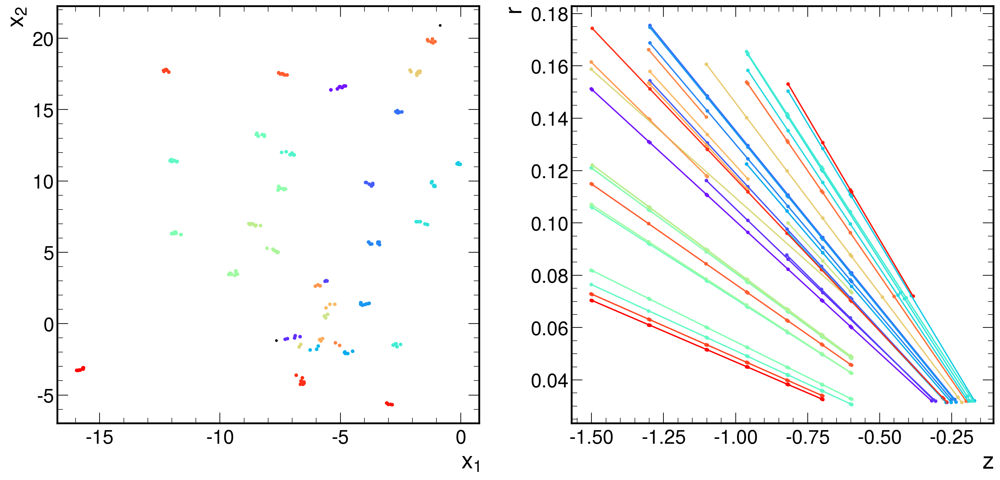

('../graphs/train1_ptmin1/event000001104_s55.npz',)
analyzing sector 55
condensation loss 0.0003618453338276595
edge weight loss tensor(0.0004)
condensation loss tensor(0.0004)
number of particles 4
number of tracks: 4
number of labels: 5
perfect match fraction: 0.75
double majority fraction: 1.0
lhc loose fraction: 1.0


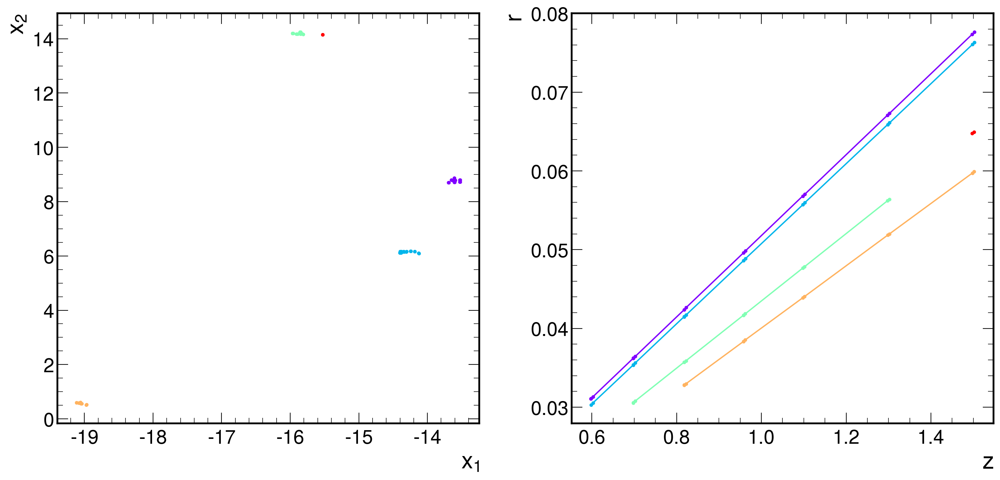

('../graphs/train1_ptmin1/event000001104_s29.npz',)
analyzing sector 29
condensation loss 0.006812278181314468
edge weight loss tensor(0.0175)
condensation loss tensor(0.0068)
number of particles 41
number of tracks: 40
number of labels: 46
perfect match fraction: 0.65
double majority fraction: 0.85
lhc loose fraction: 0.75


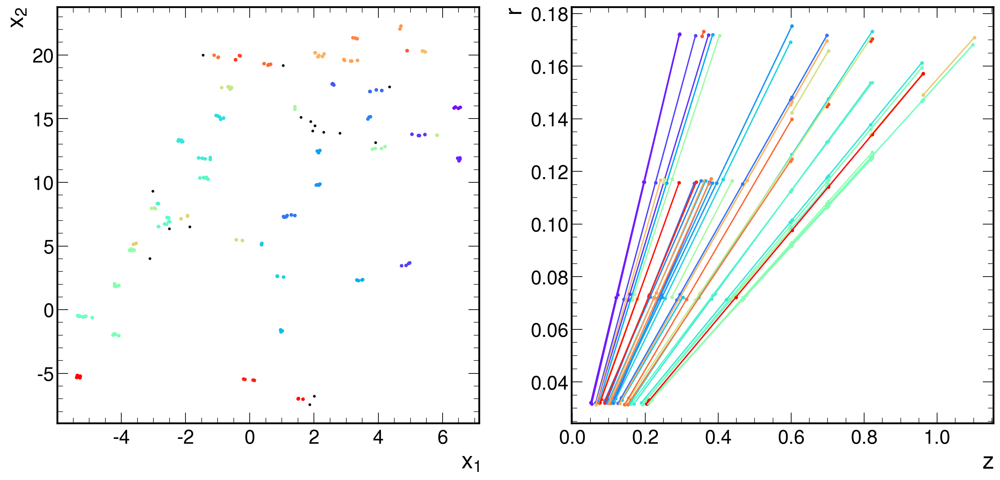

summary of full event
perfect match fraction: 0.8068669527896996
double majority fraction: 0.9393010423053342
lhc loose fraction: 0.882280809319436


In [91]:
# now calculate the efficiencies per sector across an unseen sample of graphs
gnn.eval()
thld = 0.15195
eps = {'2': 0.8063548272690922, '22': 0.299405179960324, '30': 0.28859853655239975, '29': 0.33339633574780086, '26': 0.5236165326325144, '10': 0.5216460111562207, '1': 0.2878294081123941, '48': 0.22263953508649145, '25': 0.34931555338021225, '41': 0.33230337108552677, '56': 0.20547030457458215, '53': 0.3559793988629558, '14': 0.24844131669585412, '52': 0.5608325417346683, '17': 0.3456908316257858, '37': 0.3922355410981205, '47': 0.2039827087386243, '40': 0.19807322950134404, '50': 1.1135923658563385, '43': 0.5331037394268494, '57': 0.2710876333023264, '39': 0.19920797777676114, '4': 0.44904851441225124, '20': 0.602187737520835, '36': 0.5466592138502525, '62': 0.24127534088551628, '28': 0.5347594761474337, '42': 0.41772241226028095, '15': 0.24230064272641902, '16': 0.1943095736137368, '21': 1.0508085294451583, '35': 0.378743656658796, '12': 0.5591883019759802, '33': 0.33630823925312137, '34': 0.43069772694509106, '54': 0.2785143389761452, '6': 0.306822059393292, '45': 0.46596615711030376, '23': 0.19588896863672595, '9': 0.3572548379207321, '63': 0.17333863999794852, '27': 0.6171556193101095, '13': 0.41517929321316493, '49': 0.42404231447481017, '0': 0.2740409028474836, '44': 0.4495038154213366, '58': 0.676606553714549, '61': 0.6486801322347483, '55': 0.2262980339273397, '60': 0.5528389471875124, '31': 0.22853232441126992, '18': 0.44848417813676533, '19': 0.4531880461432393, '38': 0.2857591954424449, '24': 0.2684531593154434, '5': 0.4045195515657686, '32': 0.21747424924573708, '3': 0.5348996145154985, '8': 0.2211579281046795, '7': 0.24975328523382798, '51': 0.5185944888548765, '11': 0.5056706399944967, '46': 0.25581046164540183, '59': 1.1737162383743445}
output = {'test_loss': [], 'test_acc': []}
summary_stats = {'n_pids': 0, 'perfect_matches': 0,
                 'double_majority': 0, 'lhc_loose_matches': 0}
with torch.no_grad():
    for batch_idx, (data, f) in enumerate(test_loader):
        print(f)
        sector = f[0].split('_s')[-1].split('.npz')[0]
        print('analyzing sector', sector)
        data = data.to(device)
        out, xc, beta = gnn(data.x, data.edge_index, data.edge_attr)
        y, out = data.y, out.squeeze(1)
        particle_id = data.particle_id
        
        #######################################
        # output event file for DBScan studies
        d = {'x1': xc[:,0], 'x2': xc[:,1], 'particle_id': particle_id}
        df = pd.DataFrame(data=d)
        #df.to_csv(f'../cluster_predictions/event{evt_of_interest}_s{sector}_ptmin1GeV.csv', index=False)
        #######################################
        
        loss = F.binary_cross_entropy(out, y, reduction='mean')
        loss_c = condensation_loss(beta, xc, particle_id, device=device, q_min=0.05)*10  #(10**2)
        print('condensation loss', loss_c.item())
        loss += loss_c
            
        TP = torch.sum((y==1) & (out>thld)).item()
        TN = torch.sum((y==0) & (out<thld)).item()
        FP = torch.sum((y==0) & (out>thld)).item()
        FN = torch.sum((y==1) & (out<thld)).item()
        acc = ((TP+TN)/(TP+TN+FP+FN))
        
        print('edge weight loss', loss)
        print('condensation loss', loss_c)
        output['test_acc'].append(acc)
        output['test_loss'].append(loss)
        
        n_pids = len(torch.unique(particle_id))
        nhits_per_pid = {}
        single_hit_particles = 0
        for pid in torch.unique(particle_id):
            nhits = torch.sum(particle_id==pid).item()   
            if (nhits==1): single_hit_particles += 1
            nhits_per_pid[pid.item()] = nhits    
        print('number of particles', n_pids)
        print('number of tracks:', n_pids-single_hit_particles)
            
        db = DBSCAN(eps=eps[sector], min_samples=2).fit(xc)
        labels = db.labels_
        n_clusters = len(np.unique(labels))
        print('number of labels:', n_clusters)
        cmap = list(cm.tab20c(np.linspace(0, 1, n_clusters)))
      
        perfect_matches = 0
        double_majority = 0
        lhc_loose_matches = 0
        fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(16, 8), dpi=200)
        color = iter(cm.rainbow(np.linspace(0, 1, len(np.unique(labels)))))
        for label in np.unique(labels):  
            c = next(color)
            xc_cluster = xc[labels==label]
            x_cluster = data.x[labels==label].numpy()
            
            if label==-1:
                axs[0].scatter(xc_cluster[:,0], 
                               xc_cluster[:,1], 
                               color='black', marker='.', lw=0)
                           #color=cmap[label], marker='.', lw=0)
                continue
                
            axs[0].scatter(xc_cluster[:,0], 
                           xc_cluster[:,1], 
                           color=c, marker='.')
                           #color=cmap[label], marker='.')

            idxs = np.argsort(x_cluster[:,0])
            r = x_cluster[:,0][idxs]
            z = x_cluster[:,2][idxs]
            axs[1].scatter(z, r,
                           color=c, marker='.')
            for i in range(len(r)-1):
                axs[1].plot((z[i], z[i+1]), (r[i], r[i+1]), color=c)
            
            # analyze reconstruction
            pid_cluster = particle_id[labels==label].tolist()
            N = len(pid_cluster)
            pid_counts = Counter(pid_cluster)
                                
            # handle the noise case
            if (label==-1): continue
            
            # otherwise, clusters should be tracks
            most_common = pid_counts.most_common(1)[0] # e.g. (810, 8)
            ntruth = nhits_per_pid[most_common[0]]
            if (N==most_common[1]) and (ntruth==most_common[1]):
                perfect_matches += 1
            if (most_common[1]/N > 0.5) and (most_common[1]/ntruth > 0.5):
                double_majority += 1
            if (most_common[1]/ntruth > 0.75):
                lhc_loose_matches +=1 
             

        denominator = n_pids - single_hit_particles
        print('perfect match fraction:', perfect_matches/denominator)
        print('double majority fraction:', double_majority/denominator)
        print('lhc loose fraction:', lhc_loose_matches/denominator)
        summary_stats['n_pids'] += n_pids - single_hit_particles
        summary_stats['perfect_matches'] += perfect_matches
        summary_stats['double_majority'] += double_majority
        summary_stats['lhc_loose_matches'] += lhc_loose_matches 
        axs[0].set_xlabel('$x_1$')
        axs[0].set_ylabel('$x_2$')
        axs[1].set_xlabel('$z$')
        axs[1].set_ylabel('$r$')
        plt.tight_layout()
        plt.show()
        #plt.savefig(f'../cluster_predictions/event{evt_of_interest}_s{sector}_ptmin1GeV.png', dpi=200)
    #print(eps_per_sector)
        
# entire event summary
print('summary of full event')
n_pids = summary_stats['n_pids']
print('perfect match fraction:', summary_stats['perfect_matches']/n_pids)
print('double majority fraction:', summary_stats['double_majority']/n_pids)
print('lhc loose fraction:', summary_stats['lhc_loose_matches']/n_pids)
    

In [ ]:
# now calculate the efficiencies per sector across an unseen sample of graphs
gnn.eval()
thld = 0.15195
output = {'test_loss': [], 'test_acc': []}
eps = {'2': 0.8063548272690922, '22': 0.299405179960324, '30': 0.28859853655239975, '29': 0.33339633574780086, '26': 0.5236165326325144, '10': 0.5216460111562207, '1': 0.2878294081123941, '48': 0.22263953508649145, '25': 0.34931555338021225, '41': 0.33230337108552677, '56': 0.20547030457458215, '53': 0.3559793988629558, '14': 0.24844131669585412, '52': 0.5608325417346683, '17': 0.3456908316257858, '37': 0.3922355410981205, '47': 0.2039827087386243, '40': 0.19807322950134404, '50': 1.1135923658563385, '43': 0.5331037394268494, '57': 0.2710876333023264, '39': 0.19920797777676114, '4': 0.44904851441225124, '20': 0.602187737520835, '36': 0.5466592138502525, '62': 0.24127534088551628, '28': 0.5347594761474337, '42': 0.41772241226028095, '15': 0.24230064272641902, '16': 0.1943095736137368, '21': 1.0508085294451583, '35': 0.378743656658796, '12': 0.5591883019759802, '33': 0.33630823925312137, '34': 0.43069772694509106, '54': 0.2785143389761452, '6': 0.306822059393292, '45': 0.46596615711030376, '23': 0.19588896863672595, '9': 0.3572548379207321, '63': 0.17333863999794852, '27': 0.6171556193101095, '13': 0.41517929321316493, '49': 0.42404231447481017, '0': 0.2740409028474836, '44': 0.4495038154213366, '58': 0.676606553714549, '61': 0.6486801322347483, '55': 0.2262980339273397, '60': 0.5528389471875124, '31': 0.22853232441126992, '18': 0.44848417813676533, '19': 0.4531880461432393, '38': 0.2857591954424449, '24': 0.2684531593154434, '5': 0.4045195515657686, '32': 0.21747424924573708, '3': 0.5348996145154985, '8': 0.2211579281046795, '7': 0.24975328523382798, '51': 0.5185944888548765, '11': 0.5056706399944967, '46': 0.25581046164540183, '59': 1.1737162383743445}
#eps_per_sector = {'2': 0.5495896408725386, '22': 0.2066768835039086, '30': 0.32207736849433066, '29': 0.2153735994036366, '26': 0.33333082879262993, '10': 0.4483006357560373, '1': 0.15084099122235584, '48': 0.09133902135173017, '25': 0.1851028928201932, '41': 0.21531603307034636, '56': 0.09517457366962045, '53': 0.26678582887569857, '14': 0.22142935883358877, '52': 0.3418372561998032, '17': 0.2212906430447033, '37': 0.19312759435470764, '47': 0.07242282075561883, '40': 0.043647137743399386, '50': 0.7699143485549735, '43': 0.3503989728702347, '57': 0.16920986038063074, '39': 0.0439630494567799, '4': 0.2022154563216964, '20': 0.3449003159515353, '36': 0.2526325497354306, '62': 0.13945573208896572, '28': 0.33674114954372225, '42': 0.2552393778183979, '15': 0.10452628934529434, '16': 0.10424390260245978, '21': 0.7380104344215415, '35': 0.1978508778392623, '12': 0.2676435293824886, '33': 0.2696216773866944, '34': 0.22186430182786004, '54': 0.1762268184405068, '6': 0.24255059505853188, '45': 0.2674585713555141, '23': 0.10362311667582357, '9': 0.235383881318328, '63': 0.08119582817237184, '27': 0.3838984846446019, '13': 0.3159058507535464, '49': 0.18657413342638907, '0': 0.11556407496284879, '44': 0.2883726398338603, '58': 0.42306760019056955, '61': 0.42685130034012675, '55': 0.11039074677407099, '60': 0.3684585347152781, '31': 0.11313115839546933, '18': 0.22274020570291234, '19': 0.2577446903341364, '38': 0.23418950808364947, '24': 0.10320896502403629, '5': 0.23951099655502492, '32': 0.10256076156375457, '3': 0.3988297609696611, '8': 0.13298719725169572, '7': 0.10731956348135153, '51': 0.34252400841044667, '11': 0.3431829658915274, '46': 0.19143257049887802, '59': 0.7589238164237745}

summary_stats = {'n_pids': 0, 'perfect_matches': 0,
                 'double_majority': 0, 'lhc_loose_matches': 0}

input_dir = '../graphs/ptmin_1GeV_train2'
graph_files = np.array(os.listdir(input_dir))
graph_paths = np.array([os.path.join(input_dir, graph_file)
                        for graph_file in graph_files])

params = {'batch_size': 1, 'shuffle': True, 'num_workers': 1}
test_set = GraphDataset(graph_files=graph_paths)
test_loader = DataLoader(test_set, **params)
with torch.no_grad():
    for batch_idx, (data, f) in enumerate(test_loader):
        sector = f[0].split('_s')[-1].split('.npz')[0]
        #print('analyzing sector', sector)
        data = data.to(device)
        out, xc, beta = gnn(data.x, data.edge_index, data.edge_attr)
        y, out = data.y, out.squeeze(1)
        particle_id = data.particle_id
        loss = F.binary_cross_entropy(out, y, reduction='mean')
        loss_c = condensation_loss(beta, xc, particle_id, device=device, q_min=0.05)*10  #(10**2)
        #print('condensation loss', loss_c.item())
        loss += loss_c
            
        TP = torch.sum((y==1) & (out>thld)).item()
        TN = torch.sum((y==0) & (out<thld)).item()
        FP = torch.sum((y==0) & (out>thld)).item()
        FN = torch.sum((y==1) & (out<thld)).item()
        acc = ((TP+TN)/(TP+TN+FP+FN))
    
        output['test_acc'].append(acc)
        output['test_loss'].append(loss)
        
        n_pids = len(torch.unique(particle_id))
        nhits_per_pid = {}
        single_hit_particles = 0
        for pid in torch.unique(particle_id):
            nhits = torch.sum(particle_id==pid).item()   
            if (nhits==1): single_hit_particles += 1
            nhits_per_pid[pid.item()] = nhits
       
        db = DBSCAN(eps=eps_per_sector[sector], min_samples=2).fit(xc)
        labels = db.labels_
        n_clusters = len(np.unique(labels))
        cmap = list(cm.tab20c(np.linspace(0, 1, n_clusters)))
      
        perfect_matches = 0
        double_majority = 0
        lhc_loose_matches = 0
        for label in np.unique(labels):            
            # analyze reconstruction
            pid_cluster = particle_id[labels==label].tolist()
            N = len(pid_cluster)
            pid_counts = Counter(pid_cluster)
                                
            # handle the noise case
            if (label==-1): continue
            
            # otherwise, clusters should be tracks
            most_common = pid_counts.most_common(1)[0] # e.g. (810, 8)
            ntruth = nhits_per_pid[most_common[0]]
            if (N==most_common[1]) and (ntruth==most_common[1]):
                perfect_matches += 1
            if (most_common[1]/N > 0.5) and (most_common[1]/ntruth > 0.5):
                double_majority += 1
            if (most_common[1]/ntruth > 0.75):
                lhc_loose_matches +=1 
                      
        summary_stats['n_pids'] += n_pids - single_hit_particles
        summary_stats['perfect_matches'] += perfect_matches
        summary_stats['double_majority'] += double_majority
        summary_stats['lhc_loose_matches'] += lhc_loose_matches
            
# entire event summary
print('summary of full data sample')
n_pids = summary_stats['n_pids']
print('perfect match fraction:', summary_stats['perfect_matches']/n_pids)
print('double majority fraction:', summary_stats['double_majority']/n_pids)
print('lhc loose fraction:', summary_stats['lhc_loose_matches']/n_pids)